## **PROJECT CODE: 10281**

# **Business Case**

_This project **aims to develop a model** that identifies **root causes** and isolate **non-performers** for targeted interventions, aiming to **improve overall performance** without harming **employee morale.**_


# **Project Summary**

_**INX Future Inc.** - A Data-Driven Path Forward_

1. _**At a Crossroads**: INX Future Inc., a data analytics leader, faces a critical challenge.  **Employee performance and client satisfaction**, once hallmarks of success, are **declining** despite their renowned positive work culture._

2. _**Unveiling the Root Cause**: **CEO Mr. Brain** champions a **data science initiative**.  This project will leverage INX's core expertise, meticulously scrutinizing employee data to pinpoint the exact factors **hindering performance**._

3. _**Restoring Peak Performance**: Gleaned insights will guide targeted solutions to **revitalize employee performance**.  Mr. Brain understands the delicate balance: reinvigorate performance while maintaining morale and INX's reputation as a top employer._

4. _**Identifying Underperformers**: The project will establish clear metrics to **identify underperforming employees**, enabling appropriate corrective actions for a more productive workforce._

5. _**Continued Success Through Data**: This **data-driven approach** represents INX's **strategic move**.  By harnessing their analytical prowess, they aim to reclaim leadership while safeguarding their cherished work environment.  This **innovative path** paves the way for**INX's** continued **success**._

# **Domain Analysis**

_**INX Future Inc.**: Employee Performance Deep Dive By dissecting these domains, we can uncover:_

* _**Data Spectrum:** This analysis delves into employee data at INX Future Inc., encompassing demographics, job descriptions, work environment factors, experience, performance metrics, and compensation._

* _**Demographic trends:** Age-related performance variations, potential gender gaps, and impacts of education._

* _**Job-specific challenges:** Performance differences across departments and roles, workload influences (travel, distance), and employee fit within their roles._

* _**Work environment impact:** Direct measures of satisfaction (environment & job), tenure indicators (stability & burnout), and career progression insights (promotions & company loyalty)._

* _**Performance drivers:** Correlation between training investments and performance, compensation satisfaction, and potential flight risk based on performance evaluations._

* _**Overall Value:** This rich dataset allows INX to pinpoint the root causes of declining performance and develop targeted solutions for a more productive and satisfied workforce._

# **Importing Libraries and Dataset**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import pylab
import seaborn as sns
sns.set_style('darkgrid')  # setting up background
from scipy import stats

# TO avoid warnings
import warnings
warnings.filterwarnings('ignore')

In [ ]:
data= pd.read_excel("/content/drive/MyDrive/Employee_Performance.xls")
pd.set_option('display.max_columns',None) # Used to display the all features
data

,EmpNumber,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating
0,E1001000,32,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,10,3,4,55,3,2,4,1,No,12,4,10,2,2,10,7,0,8,No,3
1,E1001006,47,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,14,4,4,42,3,2,1,2,No,12,4,20,2,3,7,7,1,7,No,3
2,E1001007,40,Male,Life Sciences,Married,Sales,Sales Executive,Travel_Frequently,5,4,4,48,2,3,1,5,Yes,21,3,20,2,3,18,13,1,12,No,4
3,E1001009,41,Male,Human Resources,Divorced,Human Resources,Manager,Travel_Rarely,10,4,2,73,2,5,4,3,No,15,2,23,2,2,21,6,12,6,No,3
4,E1001010,60,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,16,4,1,84,3,2,1,8,No,14,4,10,1,3,2,2,2,2,No,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1195,E100992,27,Female,Medical,Divorced,Sales,Sales Executive,Travel_Frequently,3,1,4,71,4,2,4,1,Yes,20,2,6,3,3,6,5,0,4,No,4
1196,E100993,37,Male,Life Sciences,Single,Development,Senior Developer,Travel_Rarely,10,2,4,80,4,1,4,3,No,17,1,4,2,3,1,0,0,0,No,3
1197,E100994,50,Male,Medical,Married,Development,Senior Developer,Travel_Rarely,28,1,4,74,4,1,3,1,Yes,11,3,20,3,3,20,8,3,8,No,3
1198,E100995,34,Female,Medical,Single,Data Science,Data Scientist,Travel_Rarely,9,3,4,46,2,3,2,1,No,14,2,9,3,4,8,7,7,7,No,3


In [ ]:
data.drop('EmpNumber',axis=1, inplace=True)
data

,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating
0,32,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,10,3,4,55,3,2,4,1,No,12,4,10,2,2,10,7,0,8,No,3
1,47,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,14,4,4,42,3,2,1,2,No,12,4,20,2,3,7,7,1,7,No,3
2,40,Male,Life Sciences,Married,Sales,Sales Executive,Travel_Frequently,5,4,4,48,2,3,1,5,Yes,21,3,20,2,3,18,13,1,12,No,4
3,41,Male,Human Resources,Divorced,Human Resources,Manager,Travel_Rarely,10,4,2,73,2,5,4,3,No,15,2,23,2,2,21,6,12,6,No,3
4,60,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,16,4,1,84,3,2,1,8,No,14,4,10,1,3,2,2,2,2,No,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1195,27,Female,Medical,Divorced,Sales,Sales Executive,Travel_Frequently,3,1,4,71,4,2,4,1,Yes,20,2,6,3,3,6,5,0,4,No,4
1196,37,Male,Life Sciences,Single,Development,Senior Developer,Travel_Rarely,10,2,4,80,4,1,4,3,No,17,1,4,2,3,1,0,0,0,No,3
1197,50,Male,Medical,Married,Development,Senior Developer,Travel_Rarely,28,1,4,74,4,1,3,1,Yes,11,3,20,3,3,20,8,3,8,No,3
1198,34,Female,Medical,Single,Data Science,Data Scientist,Travel_Rarely,9,3,4,46,2,3,2,1,No,14,2,9,3,4,8,7,7,7,No,3


**INSIGHTS**

*   _The first thing we did was importing the **essential libraries** which are needed inorder to work with the dataset._

*   _Then, we loaded the data from a **CSV file** using **pandas** a popular data analysis library, and thereby named it **data**._

*   _We used a pandas function **pd.set_option** to **display all the columns** in order to get an overview of this dataset._


# **Basic Checks**

In [ ]:
data.head()

,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating
0,32,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,10,3,4,55,3,2,4,1,No,12,4,10,2,2,10,7,0,8,No,3
1,47,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,14,4,4,42,3,2,1,2,No,12,4,20,2,3,7,7,1,7,No,3
2,40,Male,Life Sciences,Married,Sales,Sales Executive,Travel_Frequently,5,4,4,48,2,3,1,5,Yes,21,3,20,2,3,18,13,1,12,No,4
3,41,Male,Human Resources,Divorced,Human Resources,Manager,Travel_Rarely,10,4,2,73,2,5,4,3,No,15,2,23,2,2,21,6,12,6,No,3
4,60,Male,Marketing,Single,Sales,Sales Executive,Travel_Rarely,16,4,1,84,3,2,1,8,No,14,4,10,1,3,2,2,2,2,No,3


In [ ]:
data.tail()

,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating
1195,27,Female,Medical,Divorced,Sales,Sales Executive,Travel_Frequently,3,1,4,71,4,2,4,1,Yes,20,2,6,3,3,6,5,0,4,No,4
1196,37,Male,Life Sciences,Single,Development,Senior Developer,Travel_Rarely,10,2,4,80,4,1,4,3,No,17,1,4,2,3,1,0,0,0,No,3
1197,50,Male,Medical,Married,Development,Senior Developer,Travel_Rarely,28,1,4,74,4,1,3,1,Yes,11,3,20,3,3,20,8,3,8,No,3
1198,34,Female,Medical,Single,Data Science,Data Scientist,Travel_Rarely,9,3,4,46,2,3,2,1,No,14,2,9,3,4,8,7,7,7,No,3
1199,24,Female,Life Sciences,Single,Sales,Sales Executive,Travel_Rarely,3,2,1,65,3,2,3,9,No,14,1,4,3,3,2,2,2,0,Yes,2


In [ ]:
data.columns

Index(['Age', 'Gender', 'EducationBackground', 'MaritalStatus',
       'EmpDepartment', 'EmpJobRole', 'BusinessTravelFrequency',
       'DistanceFromHome', 'EmpEducationLevel', 'EmpEnvironmentSatisfaction',
       'EmpHourlyRate', 'EmpJobInvolvement', 'EmpJobLevel',
       'EmpJobSatisfaction', 'NumCompaniesWorked', 'OverTime',
       'EmpLastSalaryHikePercent', 'EmpRelationshipSatisfaction',
       'TotalWorkExperienceInYears', 'TrainingTimesLastYear',
       'EmpWorkLifeBalance', 'ExperienceYearsAtThisCompany',
       'ExperienceYearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager', 'Attrition', 'PerformanceRating'],
      dtype='object')

In [ ]:
data.shape

(1200, 27)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 27 columns):
 #   Column                        Non-Null Count  Dtype 
---  ------                        --------------  ----- 
 0   Age                           1200 non-null   int64 
 1   Gender                        1200 non-null   object
 2   EducationBackground           1200 non-null   object
 3   MaritalStatus                 1200 non-null   object
 4   EmpDepartment                 1200 non-null   object
 5   EmpJobRole                    1200 non-null   object
 6   BusinessTravelFrequency       1200 non-null   object
 7   DistanceFromHome              1200 non-null   int64 
 8   EmpEducationLevel             1200 non-null   int64 
 9   EmpEnvironmentSatisfaction    1200 non-null   int64 
 10  EmpHourlyRate                 1200 non-null   int64 
 11  EmpJobInvolvement             1200 non-null   int64 
 12  EmpJobLevel                   1200 non-null   int64 
 13  EmpJobSatisfaction

In [ ]:
data.describe()

,Age,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,PerformanceRating
count,1200.000000,1200.000000,1200.00000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000
mean,36.918333,9.165833,2.89250,2.715833,65.981667,2.731667,2.067500,2.732500,2.665000,15.222500,2.725000,11.330000,2.785833,2.744167,7.077500,4.291667,2.194167,4.105000,2.948333
std,9.087289,8.176636,1.04412,1.090599,20.211302,0.707164,1.107836,1.100888,2.469384,3.625918,1.075642,7.797228,1.263446,0.699374,6.236899,3.613744,3.221560,3.541576,0.518866
min,18.000000,1.000000,1.00000,1.000000,30.000000,1.000000,1.000000,1.000000,0.000000,11.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,2.000000
25%,30.000000,2.000000,2.00000,2.000000,48.000000,2.000000,1.000000,2.000000,1.000000,12.000000,2.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000,3.000000
50%,36.000000,7.000000,3.00000,3.000000,66.000000,3.000000,2.000000,3.000000,2.000000,14.000000,3.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000,3.000000
75%,43.000000,14.000000,4.00000,4.000000,83.000000,3.000000,3.000000,4.000000,4.000000,18.000000,4.000000,15.000000,3.000000,3.000000,10.000000,7.000000,3.000000,7.000000,3.000000
max,60.000000,29.000000,5.00000,4.000000,100.000000,4.000000,5.000000,4.000000,9.000000,25.000000,4.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000,4.000000


In [ ]:
data.describe(include="O").T

,count,unique,top,freq
Gender,1200,2,Male,725
EducationBackground,1200,6,Life Sciences,492
MaritalStatus,1200,3,Married,548
EmpDepartment,1200,6,Sales,373
EmpJobRole,1200,19,Sales Executive,270
BusinessTravelFrequency,1200,3,Travel_Rarely,846
OverTime,1200,2,No,847
Attrition,1200,2,No,1022


In [ ]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,1200.0,36.918333,9.087289,18.0,30.0,36.0,43.0,60.0
DistanceFromHome,1200.0,9.165833,8.176636,1.0,2.0,7.0,14.0,29.0
EmpEducationLevel,1200.0,2.892500,1.044120,1.0,2.0,3.0,4.0,5.0
EmpEnvironmentSatisfaction,1200.0,2.715833,1.090599,1.0,2.0,3.0,4.0,4.0
EmpHourlyRate,1200.0,65.981667,20.211302,30.0,48.0,66.0,83.0,100.0
EmpJobInvolvement,1200.0,2.731667,0.707164,1.0,2.0,3.0,3.0,4.0
EmpJobLevel,1200.0,2.067500,1.107836,1.0,1.0,2.0,3.0,5.0
EmpJobSatisfaction,1200.0,2.732500,1.100888,1.0,2.0,3.0,4.0,4.0
NumCompaniesWorked,1200.0,2.665000,2.469384,0.0,1.0,2.0,4.0,9.0
EmpLastSalaryHikePercent,1200.0,15.222500,3.625918,11.0,12.0,14.0,18.0,25.0


In [ ]:
data.isnull().sum()

Age                             0
Gender                          0
EducationBackground             0
MaritalStatus                   0
EmpDepartment                   0
EmpJobRole                      0
BusinessTravelFrequency         0
DistanceFromHome                0
EmpEducationLevel               0
EmpEnvironmentSatisfaction      0
EmpHourlyRate                   0
EmpJobInvolvement               0
EmpJobLevel                     0
EmpJobSatisfaction              0
NumCompaniesWorked              0
OverTime                        0
EmpLastSalaryHikePercent        0
EmpRelationshipSatisfaction     0
TotalWorkExperienceInYears      0
TrainingTimesLastYear           0
EmpWorkLifeBalance              0
ExperienceYearsAtThisCompany    0
ExperienceYearsInCurrentRole    0
YearsSinceLastPromotion         0
YearsWithCurrManager            0
Attrition                       0
PerformanceRating               0
dtype: int64

**INSIGHTS**

*   _We can get a basic idea of the dataset by checking its data types (**dtypes**) and dimensions **(shape)**. This helps us understand what kind of data we're working with and how it's organized._.

*   _Using **describe().T** function we can compute summary **statistics** for the **numerical columns** in the data_.

*   _Finally we **drop the duplicates** which are in the dataset and we identify the **missing values (NaN or None)** using **isnull()** function.  which identifies null values in the Dataset_

## **Uni-variate analysis**

In [ ]:
pip install sweetviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.1/15.1 MB 56.9 MB/s eta 0:00:00


                                             |          | [  0%]   00:00 -> (? left)

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



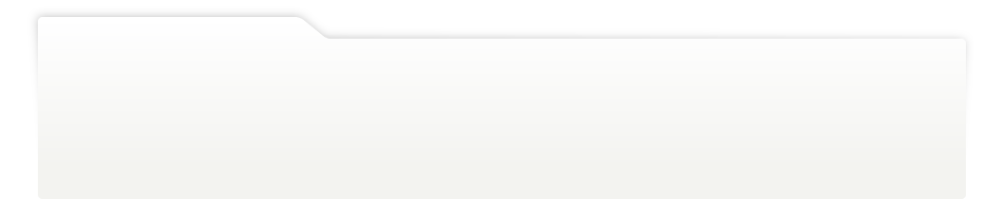
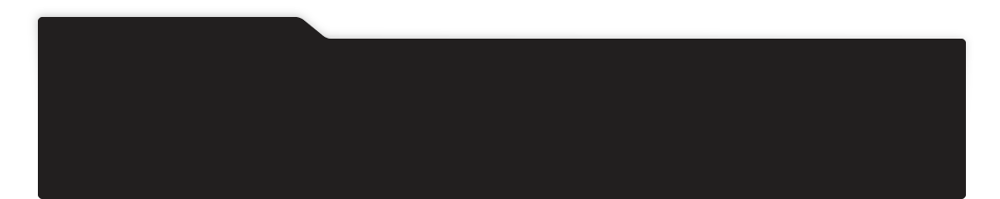
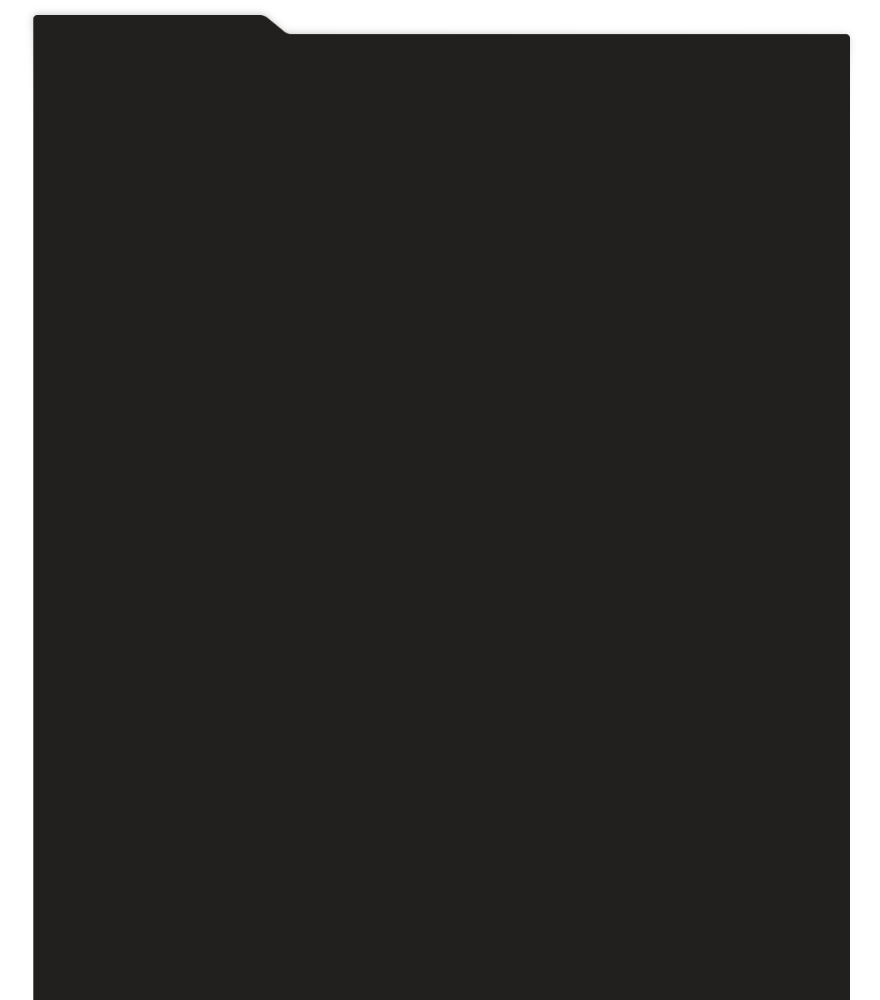
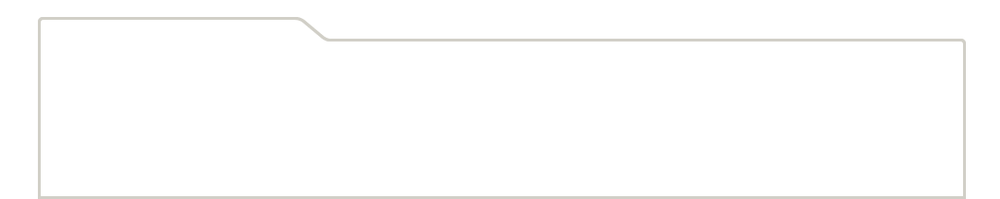
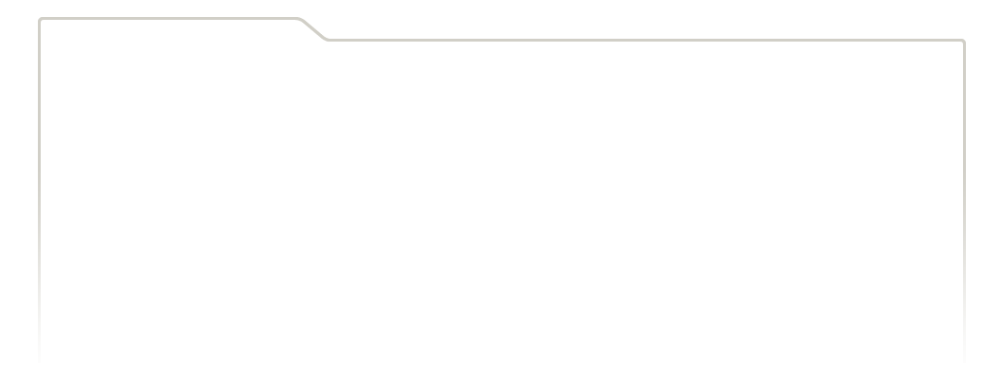
...
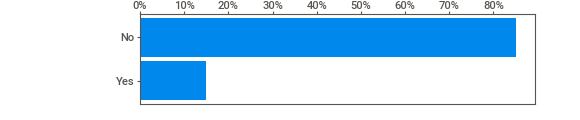
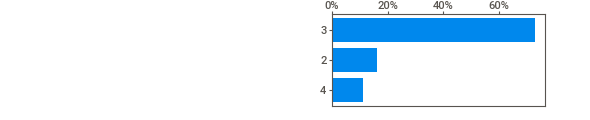
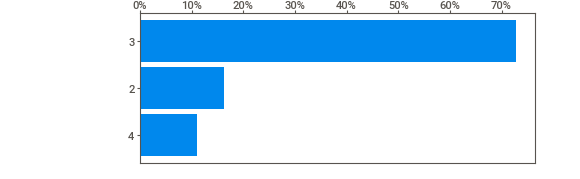
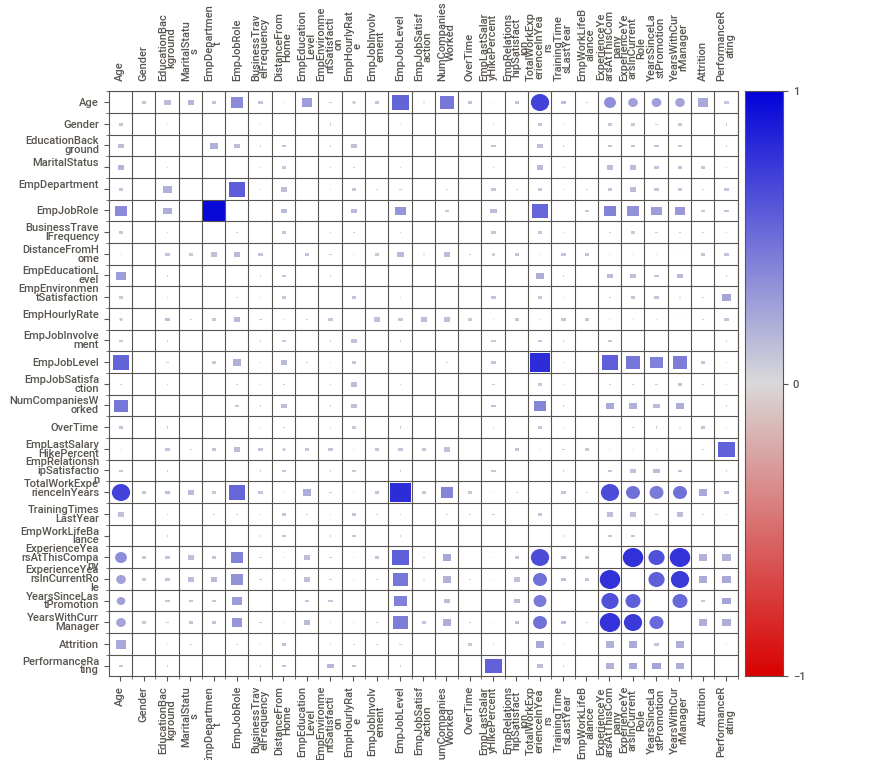
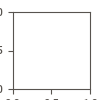

In [ ]:
import sweetviz as sv
report = sv.analyze(data)
report.show_html()
report.show_notebook()

In [ ]:
!pip install ydata_profiling[notebook]

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 359.5/359.5 kB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 12.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 12.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 24.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 27.5 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27080 sha256=c5899b318564e0f8f362a0cf3d3953efd7e47d26698893c47bd105b4c36b251f
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [ ]:
import ydata_profiling as yp

profile = yp.ProfileReport(data)
profile.to_html()
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

**INSIGHTS**

*   _**Univariate analysis** is essential because it **Unveils patterns and trends** within individual variables and lays the **groundwork** for further analysis by **highlighting potential relationships** between the variable._

*   _We can leverage the two powerful tools for data exploration: **sweetViz** and **Pandas Profiling**._

*   _**sweetViz** excels at generating **diverse visualizations** with minimal configuration. It efficiently handles  datasets, making it ideal for initial exploratory analysis._

* _With **pandas profiling**, we can get a quick overview of your data using summaries and charts._

## **Bi-variate analysis**

In [ ]:
# Categorical columns
data1 = data[['Gender','EducationBackground','MaritalStatus','EmpDepartment',
              'EmpJobRole','BusinessTravelFrequency','OverTime','Attrition']]

# Numerical columns
data2 = data[['Age','DistanceFromHome','EmpEducationLevel','EmpEnvironmentSatisfaction','EmpHourlyRate',
              'EmpJobInvolvement','EmpJobLevel','EmpJobSatisfaction','NumCompaniesWorked','EmpLastSalaryHikePercent',
              'EmpRelationshipSatisfaction','TotalWorkExperienceInYears','TrainingTimesLastYear','EmpWorkLifeBalance',
              'ExperienceYearsAtThisCompany','ExperienceYearsInCurrentRole','YearsSinceLastPromotion','YearsWithCurrManager',
              'PerformanceRating']]

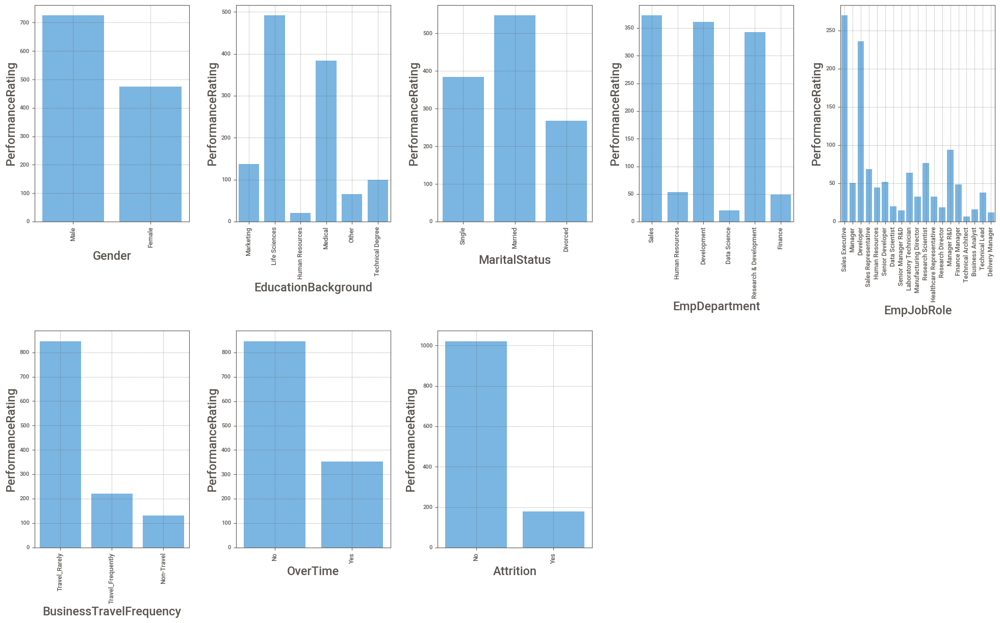

In [ ]:
plt.figure(figsize=(20, 24), facecolor='white')
plotnumber = 1
for column in data1:
  if plotnumber<=20:
    ax = plt.subplot(4,5,plotnumber)
    bar_width=0.7
    ax = plt.gca()
    for line in ax.lines:
      line.set_linewidth(0.6)
    sns.countplot(x=data1[column],ax=ax,saturation=0.7,linewidth=0.5,color='#65B8F7')
    plt.xlabel(column, fontsize=17, ha='center')
    plt.ylabel('PerformanceRating', fontsize=17)
    plt.subplots_adjust(left=0.3, right=0.7, bottom=0.3, top=0.7, wspace=0.3, hspace=0.5)
    plt.xticks(rotation=90, ha='center', fontsize=9)
    plt.yticks(verticalalignment='center')
    plt.grid(True, linestyle=':', linewidth=0.5)
    plotnumber +=1
plt.tight_layout(pad=2)
plt.show()

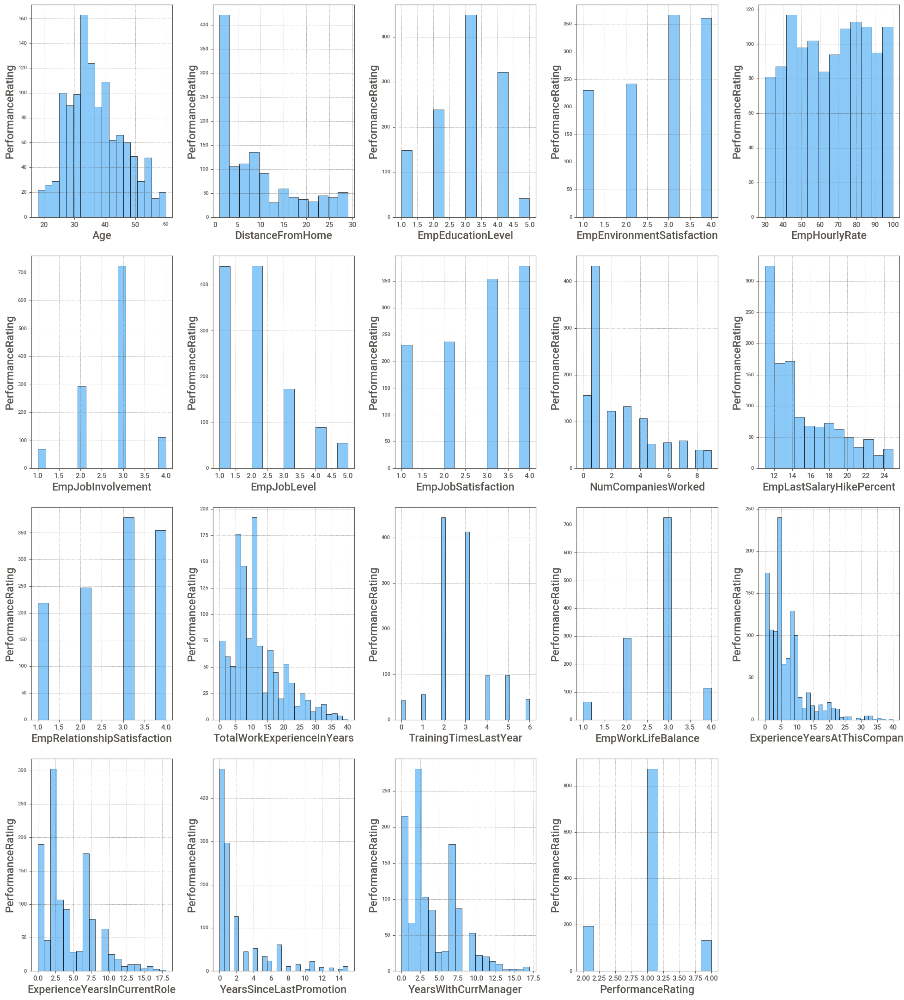

In [ ]:
plt.figure(figsize=(20, 22), facecolor='white')
plotnumber = 1
for column in data2:
  if plotnumber<=20:
    ax = plt.subplot(4,5,plotnumber)
    bar_width=0.7
    ax = plt.gca()
    for line in ax.lines:
      line.set_linewidth(0.6)
    sns.histplot(x=data2[column],ax=ax,linewidth=0.5,edgecolor='#000000', color='#65B8F7')
    plt.xlabel(column, fontsize=17, ha='center')
    plt.ylabel('PerformanceRating', fontsize=17)
    plt.subplots_adjust(left=0.3, right=0.7, bottom=0.3, top=0.7, wspace=0.3, hspace=0.5)
    plt.xticks(rotation=0, ha='center', fontsize=11)
    plt.yticks(verticalalignment='center')
    plt.grid(True, linestyle=':', linewidth=0.5)
    plotnumber +=1
plt.tight_layout(pad=2)
plt.show()

**INSIGHTS**

*   _**Bivariate analysis** examines relationships between two variables **categorical and numerical** using visualizations with **Matplotlib** and **Seaborn** and denoted as **data1** and **data2**_

*   _These visualizations, colored by a variable **hue** which reveals trends, patterns, and potential connections between the data._

*   _To effectively visualize our data, we used **countplot, barplot and violinplot** for **categorical** columns **histplot,boxplot** and **violinplot** for numerical columns which provides a clear distinction between the data types_.


## **Multivariate analysis**

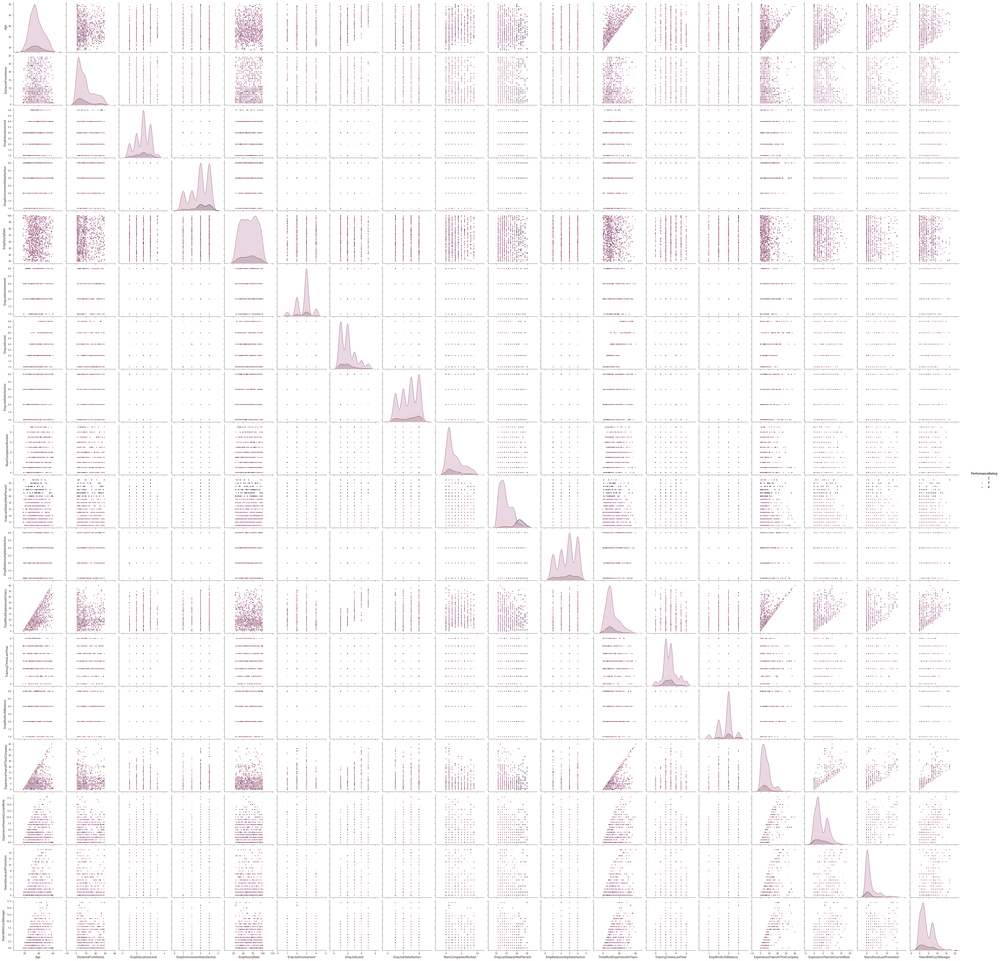

In [ ]:
sns.pairplot(data, hue='PerformanceRating')

**INSIGHTS**

*    _We used multivariate analysis to establish **inter-relationship** among different variables. **Multivariate analysis** provides insights into customer behavior at a deeper level, surpassing the constraints of single-variable analysis_.

*  _This empowers us to enhance prediction accuracy. In this dataset, we utilized **pairplot** for visualization_.


# **Visual Representation of Task**

* Task 1: _**Department wise performances**_
* Task 2: _**Top 3 Important Factors effecting employee performance**_

 **Task 1**

**PLOT USED**
* Violinplot:  It shows the distribution of quantitative data across several levels of one (or more) categorical variables such that those distributions can be compared.
* CountPlot: countplot is used to Show the counts of observations in each categorical bin using bars.

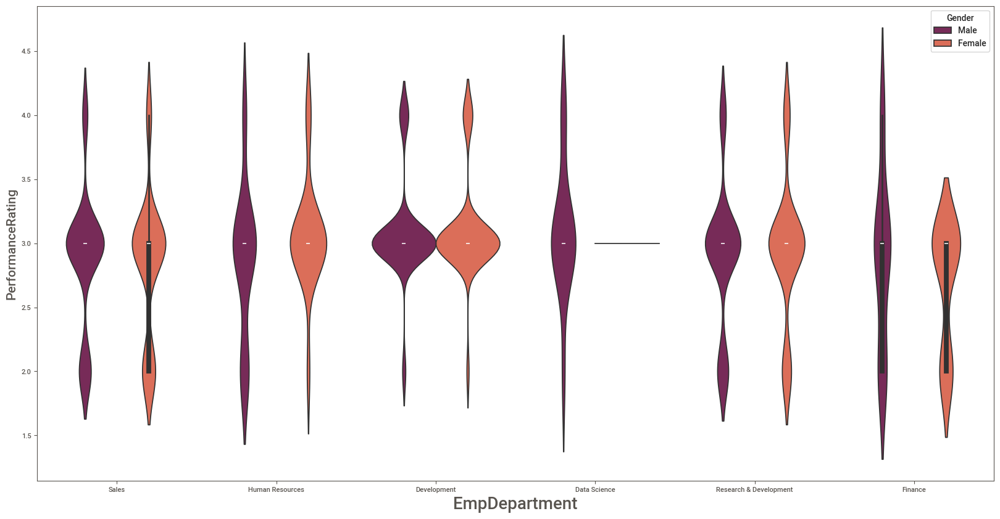

In [ ]:
plt.figure(figsize=(20,10),facecolor='white')
sns.violinplot(x='EmpDepartment',y='PerformanceRating',hue=data.Gender,data=data,palette='rocket')
plt.xlabel('EmpDepartment',fontsize=20)
plt.ylabel('PerformanceRating',fontsize=15)
plt.show()

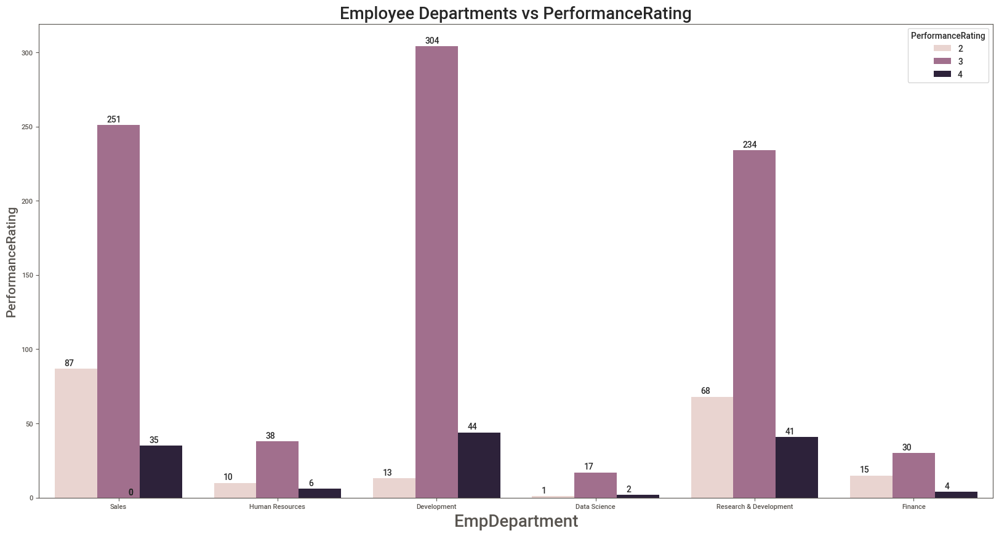

In [ ]:
plt.figure(figsize=(20,10),facecolor='white')
ax = sns.countplot(x='EmpDepartment',hue=data.PerformanceRating,data=data)
for i in ax.patches:
    ax.annotate('{:.0f}'.format(i.get_height()), (i.get_x()+0.06, i.get_height()+2))
plt.title('Employee Departments vs PerformanceRating',fontsize=20)
plt.xlabel('EmpDepartment',fontsize=20)
plt.ylabel('PerformanceRating',fontsize=15)
plt.show()

**INSIGHTS**:

From the above graph we can conclude that from the EmpDepartment Development department is showing High performance rating

**Sales**: The Performace rating level 3 is more in the sales department. The male performance rating the little bit higher compared to female.

**Human Resources**: The majority of the employees lying under the level 3 performance . The older people are performing low in this department. The female employees in HR department doing really well in their performance.

**Development**: The maximum number of employees are level 3 performers. Employees of all age are performing at the level of 3 only. The gender-based performance is nearly same for both.

**Data Science**: The highest average of level 3 performance is in data science department. Data science is the only department where less number of level 2 performers. The overall performance is higher compared to all departments. Male employees are doing good in this department.

**Research & Development**: The age factor is not deviating from the level of performance here where different employees with different age are there in every level of performance. The R&D has the good female employees in their performance.

**Finance**: The finance department performance is exponentially decreasing when age increases. The male employees are doing good. The experience factor is inversely relating to the performance level.

 **PERCENT COUNT IN EMPLOYEE DEPARTMENT WITH PERFORMANCE RATING**

In [ ]:
percent = pd.crosstab(data["PerformanceRating"], data["EmpDepartment"], margins=True,normalize=True)
round(percent.multiply(100),2)

EmpDepartment,Data Science,Development,Finance,Human Resources,Research & Development,Sales,All
PerformanceRating,,,,,,,
2,0.08,1.08,1.25,0.83,5.67,7.25,16.17
3,1.42,25.33,2.50,3.17,19.50,20.92,72.83
4,0.17,3.67,0.33,0.50,3.42,2.92,11.00
All,1.67,30.08,4.08,4.50,28.58,31.08,100.00


**TASK 3**

**TOP 3 FACTOR AFFECTING TO THE EMPLOYEE PERFORMANCE**

**From visualisation file we get the top 3 factor affecting to the employee performance**
1. Emp Environment Satisfaction
2. Emp Last Salary Hike Percent
3. Emp Work Life Balance

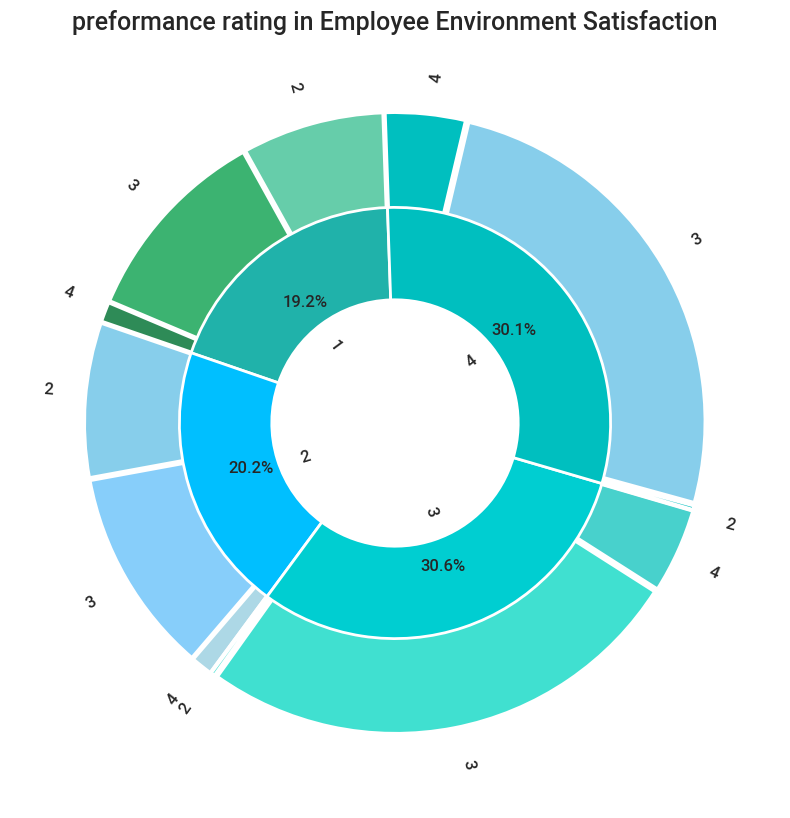

In [ ]:
# 1.Employee enviorment Satisfaction
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.title("preformance rating in Employee Environment Satisfaction",fontsize=18)
plt.pie([90,127,13,98,130,14,3,310,54,3,307,51], radius=1,
        colors=["mediumaquamarine","mediumseagreen","seagreen",
                "skyblue","lightskyblue",'lightblue',
                'turquoise','turquoise','mediumturquoise',
                'c','skyblue','c',
               ],explode =[0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.01],
        labels=[2,3,4,2,3,4,2,3,4,2,3,4],rotatelabels=True,
        pctdistance=0.82, textprops = {"fontsize":12,"fontweight":"bold"},startangle=92,
        wedgeprops=dict(width=0.6, edgecolor='w',linewidth=3))

plt.pie([230,242,367,361], radius=0.7,
        colors=['lightseagreen','deepskyblue',"darkturquoise","c"],
        wedgeprops=dict(width=0.3, edgecolor='w',linewidth=2),textprops = {"fontsize":12,"fontweight":"bold"},
        autopct='%.1f%%',
        labels=[1,2,3,4],
        pctdistance=0.70, labeldistance=0.4, rotatelabels=True,startangle=92)
plt.show()


In [ ]:
# 2.Employee last salary hike percent
pd.crosstab(data['EmpLastSalaryHikePercent'],data['PerformanceRating'],margins=True)

PerformanceRating,2,3,4,All
EmpLastSalaryHikePercent,,,,
11,28,140,1,169
12,30,123,2,155
13,27,138,3,168
14,28,140,4,172
15,11,67,4,82
16,12,54,2,68
17,9,55,3,67
18,10,63,0,73
19,10,51,2,63


In [ ]:
# 3.Employee Work life balance
pd.crosstab(data['EmpWorkLifeBalance'],data['PerformanceRating'],margins=True)

PerformanceRating,2,3,4,All
EmpWorkLifeBalance,,,,
1,16,48,0,64
2,51,216,27,294
3,115,533,79,727
4,12,77,26,115
All,194,874,132,1200


**INSIGHTS:**

**1.Employee Enviroment satisfaction:**
* Maximum Number of Employees Performance Rating belongs to EmpEnvironmentSatisfaction Level 3 & Level 4, It contains 367 & 361.

**2.Employee last salary hike percent:**
* More Number of Employees whose salary hike percentage belongs to 11-19 % are getting 2 & 3 performance rating Maximum time.
* Employees whose salary hike percentage is in between 20-22%, There performance rating is 4

**3.Employee work life balance:**
* In EmpWorkLifeBalance, level 3 is showing high Performance Rating of employees


**CHECKING THE DISTRIBUTION OF CONTINUOUS FEATURE**
- Those feature continuous in nature only use this feature to plot a distribution

**Distplot:** Distplot is used to observe how the data is distributed in a particular dataset.

In [ ]:
# Get the continuous features
data.select_dtypes('int64').head()

,Age,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,PerformanceRating
0,32,10,3,4,55,3,2,4,1,12,4,10,2,2,10,7,0,8,3
1,47,14,4,4,42,3,2,1,2,12,4,20,2,3,7,7,1,7,3
2,40,5,4,4,48,2,3,1,5,21,3,20,2,3,18,13,1,12,4
3,41,10,4,2,73,2,5,4,3,15,2,23,2,2,21,6,12,6,3
4,60,16,4,1,84,3,2,1,8,14,4,10,1,3,2,2,2,2,3


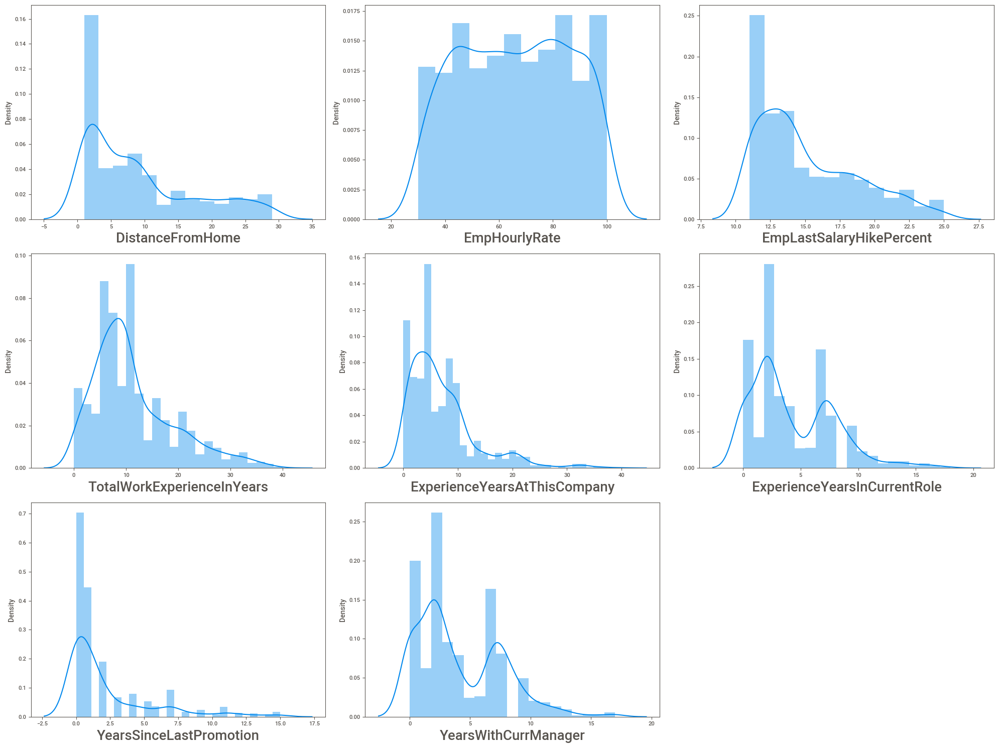

In [ ]:
# Make a list of continuous feature in nature
continuous = data[['DistanceFromHome','EmpHourlyRate','EmpLastSalaryHikePercent','TotalWorkExperienceInYears',
                   'ExperienceYearsAtThisCompany','ExperienceYearsInCurrentRole','YearsSinceLastPromotion','YearsWithCurrManager']]

plt.figure(figsize=(20,15)) # defining canvas size
plotno = 1 # counter

for column in continuous: # iteration of columns / acessing the columns from count
    if plotno<=8:    # set the limit
        plt.subplot(3,3,plotno) # # plotting 7 graphs (3-rows,3-columns) ,plotnumber is for count
        sns.distplot(x=continuous[column]) # Plotting dist plots
        plt.xlabel(column,fontsize=20)  # assigning name to x-axis and font size is 20
    plotno+=1 # counter increment
plt.tight_layout()
plt.show() # used to hide the storage loction

**CHECK THE SKEWNESS**

**Skewness:** Skewness is a measure of the asymmetry of a distribution. A distribution is asymmetrical when its left and right side are not mirror images. A distribution can have right (or positive), left (or negative), or zero skewness


In [ ]:
print('1.Distance From Home Feature Skewness:',data.DistanceFromHome.skew())
print('2.Employee Hourly Rate Feature Skewness:',data.EmpHourlyRate.skew())
print('3.Employee Last Salary Hike Percent Feature Skewness:',data.EmpLastSalaryHikePercent.skew())
print('4.Total Work Experiance In Year Feature Skewness:',data.TotalWorkExperienceInYears.skew())
print('5.Experiance Year At This Company Feature Skewness:',data.ExperienceYearsAtThisCompany.skew())
print('6.Experiance Year In Current Role Feature Skewness:',data.ExperienceYearsInCurrentRole.skew())
print('7.Year Since Last Promotion Feature Skewness:',data.YearsSinceLastPromotion.skew())
print('8.Years With Current Manager Feature Skewness:',data.YearsWithCurrManager.skew())

1.Distance From Home Feature Skewness: 0.9629561160828001
2.Employee Hourly Rate Feature Skewness: -0.035164888157941436
3.Employee Last Salary Hike Percent Feature Skewness: 0.8086536332261228
4.Total Work Experiance In Year Feature Skewness: 1.0868618597364565
5.Experiance Year At This Company Feature Skewness: 1.789054979919473
6.Experiance Year In Current Role Feature Skewness: 0.8881586703270758
7.Year Since Last Promotion Feature Skewness: 1.9749315589155791
8.Years With Current Manager Feature Skewness: 0.8131582957766446


 **CHECK THE KURTOSIS**

**Kurtosis:**  kurtosis is a measure of the "tailedness" of the probability distribution of a real-valued random variable.

In [ ]:
print('1.Distance From Home Feature kurtosis:',data.DistanceFromHome.kurtosis())
print('2.Employee Hourly Rate Feature kurtosis:',data.EmpHourlyRate.kurtosis())
print('3.Employee Last Salary Hike Percent Feature kurtosis:',data.EmpLastSalaryHikePercent.kurtosis())
print('4.Total Work Experiance In Year Feature kurtosis:',data.TotalWorkExperienceInYears.kurtosis())
print('5.Experiance Year At This Company Feature kurtosis:',data.ExperienceYearsAtThisCompany.kurtosis())
print('6.Experiance Year In Current Role Feature kurtosis:',data.ExperienceYearsInCurrentRole.kurtosis())
print('7.Year Since Last Promotion Feature kurtosis:',data.YearsSinceLastPromotion.kurtosis())
print('8.Years With Current Manager Feature kurtosis:',data.YearsWithCurrManager.kurtosis())


1.Distance From Home Feature kurtosis: -0.24201677636189256
2.Employee Hourly Rate Feature kurtosis: -1.1868905128360532
3.Employee Last Salary Hike Percent Feature kurtosis: -0.29974077544117517
4.Total Work Experiance In Year Feature kurtosis: 0.8056333333819827
5.Experiance Year At This Company Feature kurtosis: 4.057959404441291
6.Experiance Year In Current Role Feature kurtosis: 0.4380286874251209
7.Year Since Last Promotion Feature kurtosis: 3.5390800793468817
8.Years With Current Manager Feature kurtosis: 0.14820164456972984


**INSIGHTS**
-  From above all Feature skewness only one feature Year Since Last Promotion have skew so we need to do feature transformation in data preprocessing
- From above all Feature kurtosis only high in two features experiance year at this company & Year Since Last Promotion have kutosis so we need to do feature transformation in data preprocessing

**DISTRIBUTION OF MEAN OF DATA**

In [ ]:
numerical = data.select_dtypes('int64')
numerical.head()

,Age,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,PerformanceRating
0,32,10,3,4,55,3,2,4,1,12,4,10,2,2,10,7,0,8,3
1,47,14,4,4,42,3,2,1,2,12,4,20,2,3,7,7,1,7,3
2,40,5,4,4,48,2,3,1,5,21,3,20,2,3,18,13,1,12,4
3,41,10,4,2,73,2,5,4,3,15,2,23,2,2,21,6,12,6,3
4,60,16,4,1,84,3,2,1,8,14,4,10,1,3,2,2,2,2,3


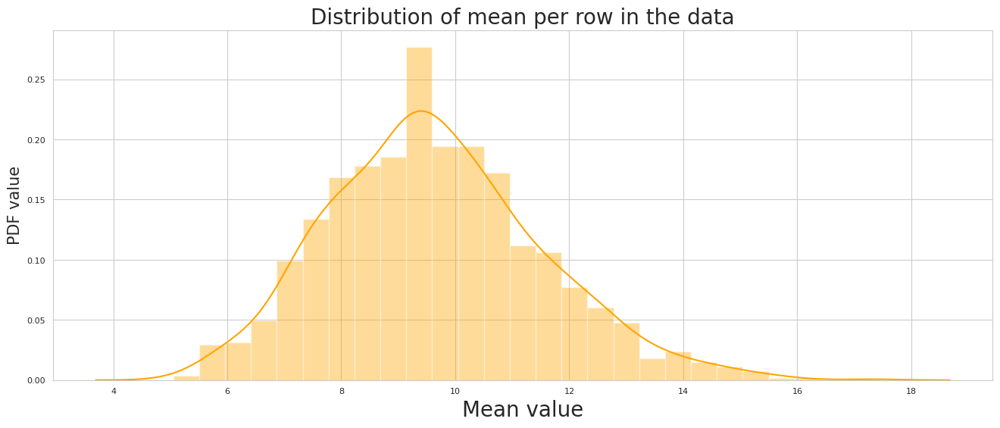

In [ ]:
plt.figure(figsize=(16,6))
sns.set_style('whitegrid')
features = numerical.columns.values[0:20]
plt.title('Distribution of mean per row in the data',fontsize=20)
plt.xlabel('Mean value',fontsize=20)
plt.ylabel('PDF value',fontsize=15)
sns.distplot(data[features].mean(axis=1),color='ORANGE', kde=True)
plt.show()

**INSIGHTS**
* From the above graph close to guassian distribution with mean value 9.5
* From above graph we can say that around 80% feature mean lies between 8.5 to 10.5

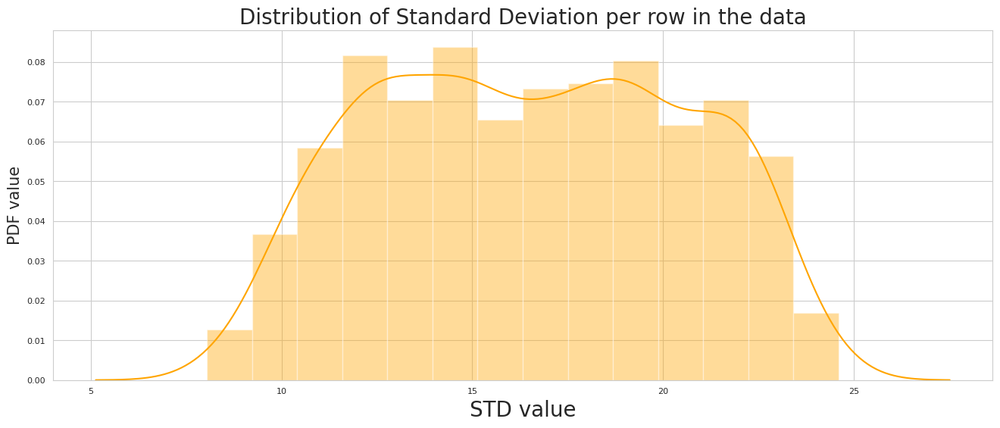

In [ ]:
plt.figure(figsize=(16,6))
sns.set_style('whitegrid')
features = numerical.columns.values[0:27]
plt.title('Distribution of Standard Deviation per row in the data',fontsize=20)
plt.xlabel('STD value',fontsize=20)
plt.ylabel('PDF value',fontsize=15)
sns.distplot(data[features].std(axis=1),color='ORANGE', kde=True)
plt.show()

**INSIGHTS**
-  This graph also look like guassian distribution around 30% of feature standard deviation around the range of 3 ,3 to 20 and remaining 70% feature standard deviation in between 0 to 2


# **Data Preprocessing**

*   _Data Cleaning_

*  _Data Transformation_

In [ ]:
data.isnull().sum()



Age                             0
Gender                          0
EducationBackground             0
MaritalStatus                   0
EmpDepartment                   0
EmpJobRole                      0
BusinessTravelFrequency         0
DistanceFromHome                0
EmpEducationLevel               0
EmpEnvironmentSatisfaction      0
EmpHourlyRate                   0
EmpJobInvolvement               0
EmpJobLevel                     0
EmpJobSatisfaction              0
NumCompaniesWorked              0
OverTime                        0
EmpLastSalaryHikePercent        0
EmpRelationshipSatisfaction     0
TotalWorkExperienceInYears      0
TrainingTimesLastYear           0
EmpWorkLifeBalance              0
ExperienceYearsAtThisCompany    0
ExperienceYearsInCurrentRole    0
YearsSinceLastPromotion         0
YearsWithCurrManager            0
Attrition                       0
PerformanceRating               0
dtype: int64

In [ ]:
null_cols = data.columns[data.isnull().any()]
print("The Column with Null Values:", null_cols)


The Column with Null Values: Index([], dtype='object')


In [ ]:
total_cells = np.product(data.shape)
total_missing = data.isnull().sum().sum()
percentage_missing = (total_missing/total_cells)*100
print("Percentage of Overall Missing Values :", percentage_missing, "%")

Percentage of Overall Missing Values : 0.0 %


**INSIGHTS**

*   _**Missing values** can significantly impact the data.  They can lead to **biased results, inaccurate models**, and reduced efficiency of algorithms._

*   _We utilized the **data.columns[data.isnull().any()]** function to detect any **null values** which are in the dataset and calculated the percentage of missing data across the dataset_.

*  _Fortunately, the dataset exhibits **No missing values**._

### **Encoding**

In [ ]:
categorical_column = [col for col,
                      dtype in data.dtypes.items()
                      if str(dtype) in ('object', 'categorical')]
categorical_column

['Gender',
 'EducationBackground',
 'MaritalStatus',
 'EmpDepartment',
 'EmpJobRole',
 'BusinessTravelFrequency',
 'OverTime',
 'Attrition']

In [ ]:
numerical_column = [col for col,
                    dtype in data.dtypes.items()
                    if np.issubdtype (dtype, np.number)]
numerical_column

['Age',
 'DistanceFromHome',
 'EmpEducationLevel',
 'EmpEnvironmentSatisfaction',
 'EmpHourlyRate',
 'EmpJobInvolvement',
 'EmpJobLevel',
 'EmpJobSatisfaction',
 'NumCompaniesWorked',
 'EmpLastSalaryHikePercent',
 'EmpRelationshipSatisfaction',
 'TotalWorkExperienceInYears',
 'TrainingTimesLastYear',
 'EmpWorkLifeBalance',
 'ExperienceYearsAtThisCompany',
 'ExperienceYearsInCurrentRole',
 'YearsSinceLastPromotion',
 'YearsWithCurrManager',
 'PerformanceRating']

In [ ]:
float_column = data.select_dtypes(include='float64').columns
float_column

Index([], dtype='object')

In [ ]:
from sklearn.preprocessing import LabelEncoder
encoder = LabelEncoder()

for col in categorical_column:
  data[col]=encoder.fit_transform(data[col])

for col in numerical_column:
  data[col]=encoder.fit_transform(data[col])

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 27 columns):
 #   Column                        Non-Null Count  Dtype
---  ------                        --------------  -----
 0   Age                           1200 non-null   int64
 1   Gender                        1200 non-null   int64
 2   EducationBackground           1200 non-null   int64
 3   MaritalStatus                 1200 non-null   int64
 4   EmpDepartment                 1200 non-null   int64
 5   EmpJobRole                    1200 non-null   int64
 6   BusinessTravelFrequency       1200 non-null   int64
 7   DistanceFromHome              1200 non-null   int64
 8   EmpEducationLevel             1200 non-null   int64
 9   EmpEnvironmentSatisfaction    1200 non-null   int64
 10  EmpHourlyRate                 1200 non-null   int64
 11  EmpJobInvolvement             1200 non-null   int64
 12  EmpJobLevel                   1200 non-null   int64
 13  EmpJobSatisfaction            120

**INSIGHTS**

*   _By converting text and categories into a numerical language, **Encoding** unlocks the ability of **machine learning models** to **decrypt** connections between features and thereby leading to sharper predictions._

*   _We applied the **OneHot Encoder** technique for encoding. Utilizing label encoding within a **For Loop function**, we iterated through both the categorical and float columns, **converting** them to **int64**_.

### **Handling Outliers**

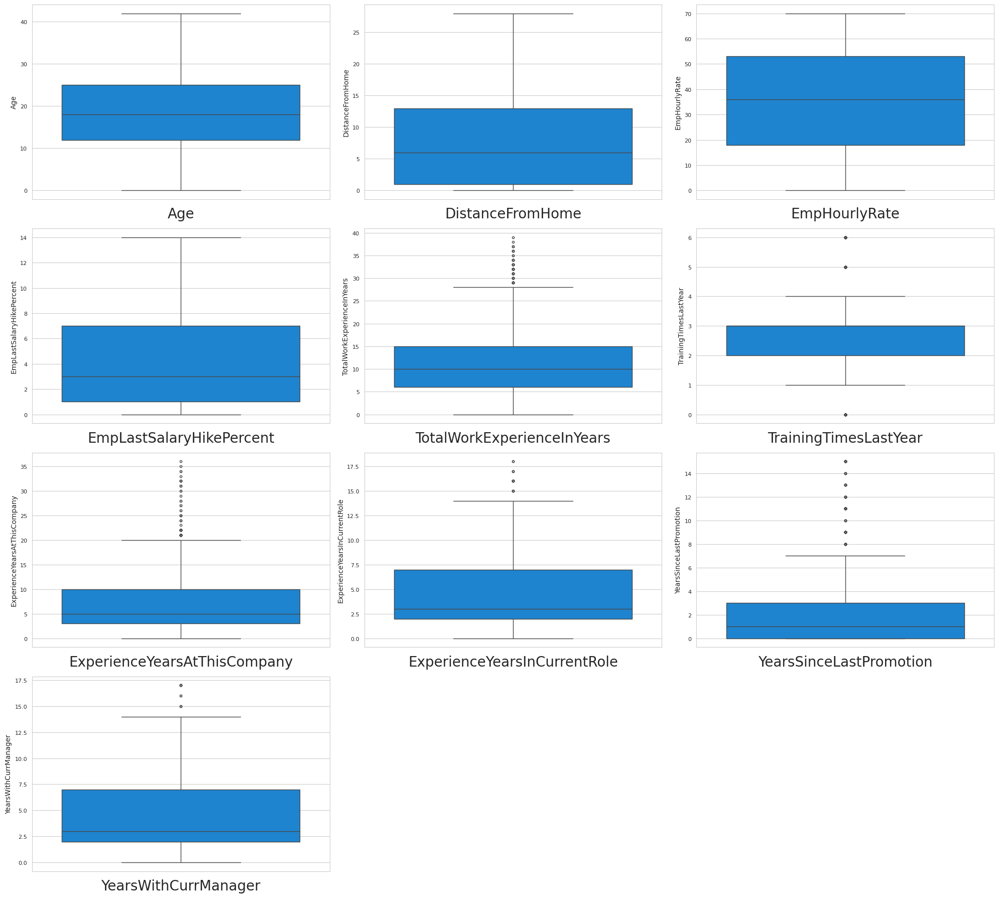

In [ ]:
out = data[['Age','DistanceFromHome','EmpHourlyRate','EmpLastSalaryHikePercent',
                   'TotalWorkExperienceInYears','TrainingTimesLastYear','ExperienceYearsAtThisCompany',
                   'ExperienceYearsInCurrentRole','YearsSinceLastPromotion','YearsWithCurrManager']]

plt.figure(figsize=(20,18)) # defining canvas size
plotno = 1 # counter

for column in out: # iteration of columns / acessing the columns from count
    if plotno<=12:    # set the limit
        plt.subplot(4,3,plotno) # # plotting 7 graphs (3-rows,3-columns) ,plotnumber is for count
        sns.boxplot(out[column]) # Plotting box plots to detect the outlier
        plt.xlabel(column,fontsize=20)  # assigning name to x-axis and font size is 20
    plotno+=1 # counter increment
plt.tight_layout()
plt.show() # used to hide the storage loction

In [ ]:
# Use iqr range because some skewed in data
iqr = stats.iqr(data['TotalWorkExperienceInYears'],interpolation='midpoint')
print("IQR:",iqr)

# Getting first & third quantile
Q1 = data['TotalWorkExperienceInYears'].quantile(0.25)
Q3 = data['TotalWorkExperienceInYears'].quantile(0.75)

# Get maximum and minimum limit
min_limit = Q1 - 1.5*iqr
print("Minimum limit:",min_limit)

max_limit = Q3 + 1.5*iqr
print("Maximum Limit:",max_limit)

IQR: 9.0
Minimum limit: -7.5
Maximum Limit: 28.5


In [ ]:
# Impute outlier
data.loc[data['TotalWorkExperienceInYears'] > max_limit,'TotalWorkExperienceInYears']=data['TotalWorkExperienceInYears'].median()

In [ ]:
# filtering data after imputation
data.loc[data['TotalWorkExperienceInYears'] > max_limit]

,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating


In [ ]:
# Use iqr range because some skewed in data
iqr = stats.iqr(data['TrainingTimesLastYear'],interpolation='midpoint')
print("IQR:",iqr)

# Getting first & third quantile
Q1 = data['TrainingTimesLastYear'].quantile(0.25)
Q3 = data['TrainingTimesLastYear'].quantile(0.75)

# Get maximum and minimum limit
min_limit = Q1 - 1.5*iqr
print("Minimum limit:",min_limit)

max_limit = Q3 + 1.5*iqr
print("Maximum Limit:",max_limit)

IQR: 1.0
Minimum limit: 0.5
Maximum Limit: 4.5


In [ ]:
# Impute outlier in max & minmum limit
data.loc[data['TrainingTimesLastYear'] < min_limit,'TrainingTimesLastYear']=data['TrainingTimesLastYear'].median()
data.loc[data['TrainingTimesLastYear'] > max_limit,'TrainingTimesLastYear']=data['TrainingTimesLastYear'].median()

In [ ]:
# Filtering the min limit
data.loc[data['TrainingTimesLastYear'] < min_limit]

,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating


In [ ]:
# Filtering the max limit
data.loc[data['TrainingTimesLastYear'] > max_limit]

,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating


In [ ]:
# Use iqr range because some skewed in data
iqr = stats.iqr(data['ExperienceYearsAtThisCompany'],interpolation='midpoint')
print("IQR:",iqr)

# Getting first & third quantile
Q1 = data['ExperienceYearsAtThisCompany'].quantile(0.25)
Q3 = data['ExperienceYearsAtThisCompany'].quantile(0.75)

# Get maximum and minimum limit
min_limit = Q1 - 1.5*iqr
print("Minimum limit:",min_limit)

max_limit = Q3 + 1.5*iqr
print("Maximum Limit:",max_limit)

IQR: 7.0
Minimum limit: -7.5
Maximum Limit: 20.5


In [ ]:
# Impute outlier
data.loc[data['ExperienceYearsAtThisCompany'] > max_limit,'ExperienceYearsAtThisCompany']=data['ExperienceYearsAtThisCompany'].median()

In [ ]:
# Filtering the data
data.loc[data['ExperienceYearsAtThisCompany'] > max_limit]

,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating


In [ ]:
# Use iqr range because some skewed in data
iqr = stats.iqr(data['ExperienceYearsInCurrentRole'],interpolation='midpoint')
print("IQR:",iqr)

# Getting first & third quantile
Q1 = data['ExperienceYearsInCurrentRole'].quantile(0.25)
Q3 = data['ExperienceYearsInCurrentRole'].quantile(0.75)

# Get maximum and minimum limit
min_limit = Q1 - 1.5*iqr
print("Minimum limit:",min_limit)

max_limit = Q3 + 1.5*iqr
print("Maximum Limit:",max_limit)

IQR: 5.0
Minimum limit: -5.5
Maximum Limit: 14.5


In [ ]:
# Impute the outlier
data.loc[data['ExperienceYearsInCurrentRole'] > max_limit,'ExperienceYearsInCurrentRole'] = data['ExperienceYearsInCurrentRole'].median()

In [ ]:
# Filtering the data
data.loc[data['ExperienceYearsInCurrentRole'] > max_limit]

,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating


In [ ]:
# use iqr because some skewed in data
iqr = stats.iqr(data['YearsSinceLastPromotion'],interpolation='midpoint')
print("IQR:",iqr)

# Get first and third quantile
Q1 = data['YearsSinceLastPromotion'].quantile(0.25)
Q3 = data['YearsSinceLastPromotion'].quantile(0.75)

# Get manimum and maximum limit
min_limit = Q1 - 1.5*iqr
print("Minimum limit:",min_limit)

max_limit = Q3 +1.5*iqr
print("Maximum limit",max_limit)

IQR: 3.0
Minimum limit: -4.5
Maximum limit 7.5


In [ ]:
# impute outlier
data.loc[data['YearsSinceLastPromotion'] > max_limit,'YearsSinceLastPromotion']=data['YearsSinceLastPromotion'].median()

In [ ]:
# Filtering data
data.loc[data['YearsSinceLastPromotion'] > max_limit]

,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating


In [ ]:
# use iqr because some skewed in data
iqr = stats.iqr(data['YearsWithCurrManager'],interpolation='midpoint')
print("IQR:",iqr)

# Get first and third quantile
Q1 = data['YearsWithCurrManager'].quantile(0.25)
Q3 = data['YearsWithCurrManager'].quantile(0.75)

# Get manimum and maximum limit
min_limit = Q1 - 1.5*iqr
print("Minimum limit:",min_limit)

max_limit = Q3 +1.5*iqr
print("Maximum limit",max_limit)

IQR: 5.0
Minimum limit: -5.5
Maximum limit 14.5


In [ ]:
# impute outlier
data.loc[data['YearsWithCurrManager'] > max_limit,'YearsWithCurrManager']=data['YearsWithCurrManager'].median()

In [ ]:
# Filtering the data
data.loc[data['YearsWithCurrManager'] >max_limit]

,Age,Gender,EducationBackground,MaritalStatus,EmpDepartment,EmpJobRole,BusinessTravelFrequency,DistanceFromHome,EmpEducationLevel,EmpEnvironmentSatisfaction,EmpHourlyRate,EmpJobInvolvement,EmpJobLevel,EmpJobSatisfaction,NumCompaniesWorked,OverTime,EmpLastSalaryHikePercent,EmpRelationshipSatisfaction,TotalWorkExperienceInYears,TrainingTimesLastYear,EmpWorkLifeBalance,ExperienceYearsAtThisCompany,ExperienceYearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition,PerformanceRating


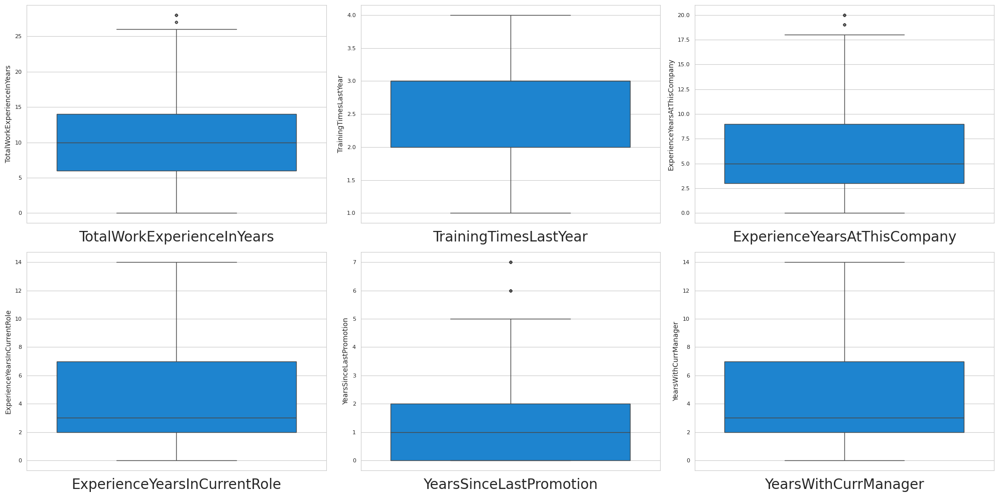

In [ ]:
out = data[['TotalWorkExperienceInYears','TrainingTimesLastYear','ExperienceYearsAtThisCompany',
            'ExperienceYearsInCurrentRole','YearsSinceLastPromotion','YearsWithCurrManager']]

plt.figure(figsize=(20,10)) # defining canvas size
plotno = 1 # counter

for column in out: # iteration of columns / acessing the columns from count
    if plotno<=7:    # set the limit
        plt.subplot(2,3,plotno) # # plotting 7 graphs (3-rows,3-columns) ,plotnumber is for count
        sns.boxplot(out[column]) # Plotting box plots to detect the outlier
        plt.xlabel(column,fontsize=20)  # assigning name to x-axis and font size is 20
    plotno+=1 # counter increment
plt.tight_layout()
plt.show() # used to hide the storage loction

In [ ]:
# define a function to plot a Q-Q plot
def plot_data(data,feature):
    plt.figure(figsize=(10,5))
    plt.subplot(1,2,1)
    data[feature].hist()
    plt.subplot(1,2,2)
    stats.probplot(data[feature],dist='norm',plot=pylab)
    plt.show()

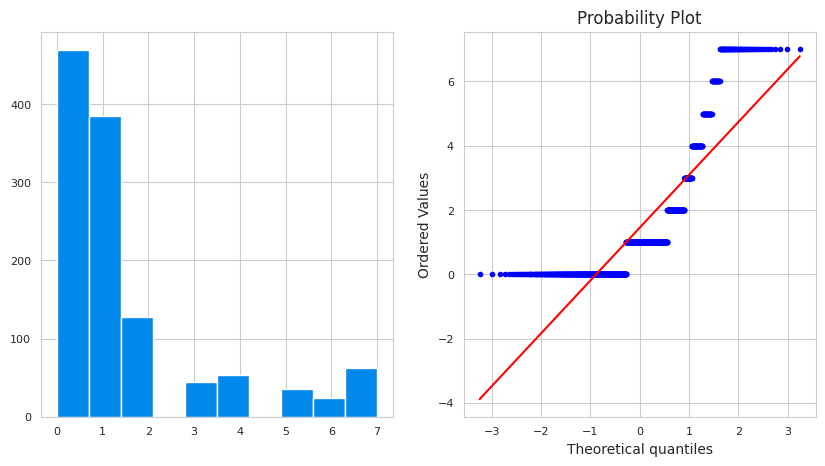

In [ ]:
plot_data(data,'YearsSinceLastPromotion')

In [ ]:
data['square_YearsSinceLastPromotion'] = data.YearsSinceLastPromotion**(1/2)

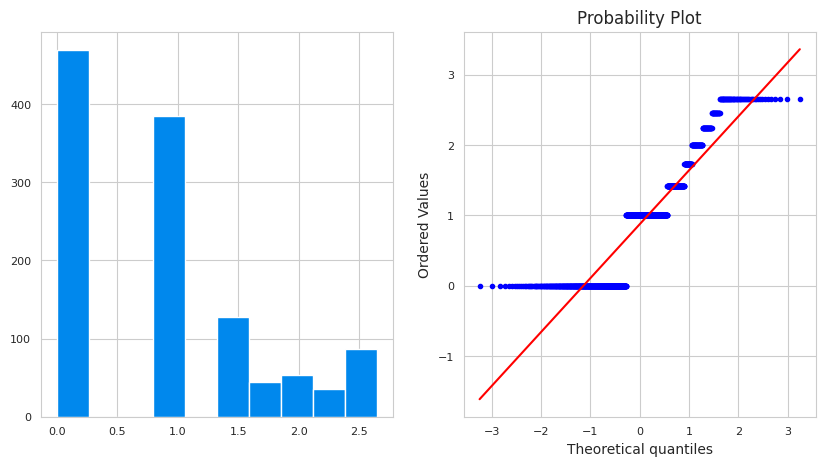

In [ ]:
plot_data(data,'square_YearsSinceLastPromotion')

**INSIGHTS**
- For comparing the distribution of a numerical variable across different categories of a categorical variable, Sweetviz can create box plots.

- These plots provide insights into the central tendency, spread, and variability of the numerical variable within each category.

- Check for missing values in each feature.Assess how many data points are missing and if they are concentrated in specific features.But here no null values present.

- Checking the outliers and solve it with the help of IQR method. But here the outlier is above 5% so I can't handle it.


correlation = data.corr()

Top_factors = correlation['PerformanceRating'].drop('PerformanceRating').sort_values(ascending=False).head(3).index.tolist()
Top_factors

import plotly.express as px
fig = px.bar(
    x=Top_factors,
    y=[correlation['PerformanceRating'][factor] for factor in Top_factors],
    title="Top Factors Influencing Employee Performance",
    text=[f"{correlation['PerformanceRating'][factor]:.2f}" for factor in Top_factors],
    width=800)

fig.update_xaxes(title_text="Factors")
fig.update_yaxes(title_text="Performance Rating")
fig.show()


 Dropping employee number because this is a constant column as well as drop Years Since Last Promotion because we create a new feaure using square root tr
data.drop(['EmpNumber','YearsSinceLastPromotion'],axis=1,inplace=True)

data.duplicated().sum()

### **PRINCIPLE COMPONENT ANALYSIS**

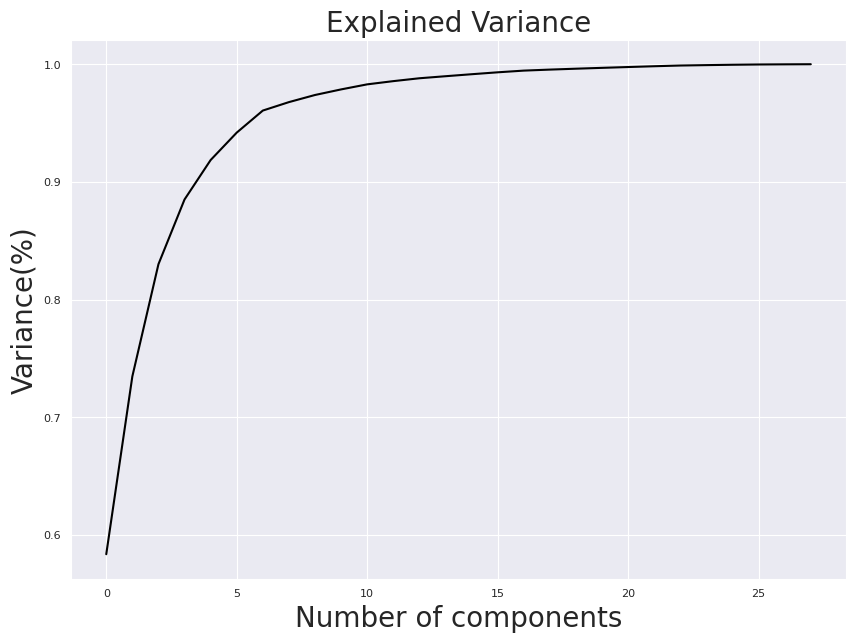

In [ ]:
# Getting the optimal value of PCA
from sklearn.decomposition import PCA

# Object creation
pca = PCA()

principlecomponent = pca.fit_transform(data)
plt.figure(figsize=(10,7))
sns.set_style('darkgrid')
plt.plot(np.cumsum(pca.explained_variance_ratio_),color='k')
plt.xlabel('Number of components',fontsize=20)
plt.ylabel('Variance(%)',fontsize=20) # for each componant
plt.title('Explained Variance',fontsize=20)
plt.show()

In [ ]:
# Selecting the components
pca = PCA(n_components=25)
new_data = pca.fit_transform(data)
new_data

array([[ 11.18777604,  -2.41951876,   1.42356034, ...,  -0.08120771,
         -0.49626947,  -0.21267524],
       [ 23.44781078,  15.02017374,   4.09213594, ...,  -0.52804855,
         -0.55625828,  -0.29099125],
       [ 17.84424113,  12.11504832,  -3.83481751, ...,  -0.06435941,
         -0.17540095,   0.8224907 ],
       ...,
       [ -8.63689384,  19.72290255,  18.05293827, ...,  -0.59119164,
         -0.21222837,   0.74712384],
       [ 20.10234271,  -0.9419521 ,   0.03918261, ...,  -0.32338669,
          0.35215807,  -0.50436232],
       [  1.53167792, -15.26954121,  -5.22428846, ...,   0.19537557,
          0.39993303,  -0.16184376]])

In [ ]:
principle_df = pd.DataFrame(data=new_data,columns=['pca1','pca2','pca3','pca4','pca5','pca6','pca7','pca8','pca9','pca10',
                            'pca11','pca12','pca13','pca14','pca15','pca16','pca17','pca18','pca19','pca20','pca21','pca22',
                            'pca23','pca24','pca25'])

# Add target veriable to preprocess dataframe for model building & evaluation
principle_df['PerformanceRating']=data.PerformanceRating

principle_df.head()

,pca1,pca2,pca3,pca4,pca5,pca6,pca7,pca8,pca9,pca10,pca11,pca12,pca13,pca14,pca15,pca16,pca17,pca18,pca19,pca20,pca21,pca22,pca23,pca24,pca25,PerformanceRating
0,11.187776,-2.419519,1.423560,-7.136682,-3.554438,-1.656268,-3.286527,-0.700559,0.772527,2.465232,-1.405750,-0.564690,-0.089632,-0.340517,-0.872727,-1.900508,-0.809675,-0.388026,0.642402,1.086689,-0.435445,-0.493016,-0.081208,-0.496269,-0.212675,1
1,23.447811,15.020174,4.092136,-1.465855,-3.848145,2.805363,-3.203897,-2.132007,-1.422051,1.405974,-1.443312,-0.485205,0.277833,-1.517876,1.489507,-0.564990,-1.527013,-1.513412,0.775463,0.373684,-0.064765,-1.075844,-0.528049,-0.556258,-0.290991,1
2,17.844241,12.115048,-3.834818,-15.428651,-3.114975,-1.740088,5.968129,3.257659,0.821744,1.748802,-2.464285,-0.964866,-0.615593,-2.019037,1.226430,0.021818,-1.052355,-0.278539,0.287473,-0.040783,1.070120,-0.202898,-0.064359,-0.175401,0.822491,2
3,-7.339991,9.899158,0.300898,-3.646946,1.913802,7.836448,0.377901,-1.994464,-2.241328,1.104975,-1.426814,-0.883257,-2.407184,0.773584,-1.287096,0.470273,-0.522152,1.535135,-0.510572,0.966519,0.540672,0.735757,-0.209260,-0.491522,-0.196581,1
4,-18.940305,17.688042,4.848872,14.700011,-6.197685,-3.467310,-1.664348,3.507462,-1.332070,0.022696,0.494032,-1.131377,0.374732,1.010151,2.363950,0.154402,-0.286499,-0.079368,0.821393,0.521538,0.392551,-1.648472,-0.617474,-0.445672,-0.183581,1


In [ ]:
principle_df.to_csv('employee_performance_analysis_preprocessed_data.csv')

# Reading new preprocess csv file
data = pd.read_csv('employee_performance_analysis_preprocessed_data.csv')

# Get first five rows
data.head()

,Unnamed: 0,pca1,pca2,pca3,pca4,pca5,pca6,pca7,pca8,pca9,pca10,pca11,pca12,pca13,pca14,pca15,pca16,pca17,pca18,pca19,pca20,pca21,pca22,pca23,pca24,pca25,PerformanceRating
0,0,11.187776,-2.419519,1.423560,-7.136682,-3.554438,-1.656268,-3.286527,-0.700559,0.772527,2.465232,-1.405750,-0.564690,-0.089632,-0.340517,-0.872727,-1.900508,-0.809675,-0.388026,0.642402,1.086689,-0.435445,-0.493016,-0.081208,-0.496269,-0.212675,1
1,1,23.447811,15.020174,4.092136,-1.465855,-3.848145,2.805363,-3.203897,-2.132007,-1.422051,1.405974,-1.443312,-0.485205,0.277833,-1.517876,1.489507,-0.564990,-1.527013,-1.513412,0.775463,0.373684,-0.064765,-1.075844,-0.528049,-0.556258,-0.290991,1
2,2,17.844241,12.115048,-3.834818,-15.428651,-3.114975,-1.740088,5.968129,3.257659,0.821744,1.748802,-2.464285,-0.964866,-0.615593,-2.019037,1.226430,0.021818,-1.052355,-0.278539,0.287473,-0.040783,1.070120,-0.202898,-0.064359,-0.175401,0.822491,2
3,3,-7.339991,9.899158,0.300898,-3.646946,1.913802,7.836448,0.377901,-1.994464,-2.241328,1.104975,-1.426814,-0.883257,-2.407184,0.773584,-1.287096,0.470273,-0.522152,1.535135,-0.510572,0.966519,0.540672,0.735757,-0.209260,-0.491522,-0.196581,1
4,4,-18.940305,17.688042,4.848872,14.700011,-6.197685,-3.467310,-1.664348,3.507462,-1.332070,0.022696,0.494032,-1.131377,0.374732,1.010151,2.363950,0.154402,-0.286499,-0.079368,0.821393,0.521538,0.392551,-1.648472,-0.617474,-0.445672,-0.183581,1


**INSIGHTS**

* Principal component analysis (PCA) is a popular technique for analyzing large datasets containing a high number of dimensions/features per observation, increasing the interpretability of data while preserving the maximum amount of information, and enabling the visualization of multidimensional data. Formally, PCA is a statistical technique for reducing the dimensionality of a dataset.

- Used For: The dataset contain more than 25 feature, removes the noise in the data and keeps only the most important features in the dataset. That will mitigate the overfitting of the data and increase the model's performance.

- Observation: Data is contain total 27 feature after dropping unique and constant column,from above PCA it shows the 25 feature has less varaince loss, so we are going to select 25 feature.



## **Data Transformation**

* _Data Splitting_

* _Feature Selection_

* _Feature Scaling_

* _Handling Imbalanced Data_

### **Data Splitting**

In [ ]:
x = data.drop('PerformanceRating',axis=1)
y = data['PerformanceRating']

In [ ]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.20,random_state=43)

In [ ]:
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(960, 26)
(240, 26)
(960,)
(240,)


**INSIGHTS**

*  _Splitting data into **training and testing** sets helps us to avoid overfitting **(memorizing training data)** and ensures the model to perform its task hastily_.

*   _For Splitting the data we used **Train test split** from **scikit learn** library_

*   _Then we assigned a **test size** and **random state** to control the Split Ratio and reproducible Results_

### **Feature Selection**

<Axes: >

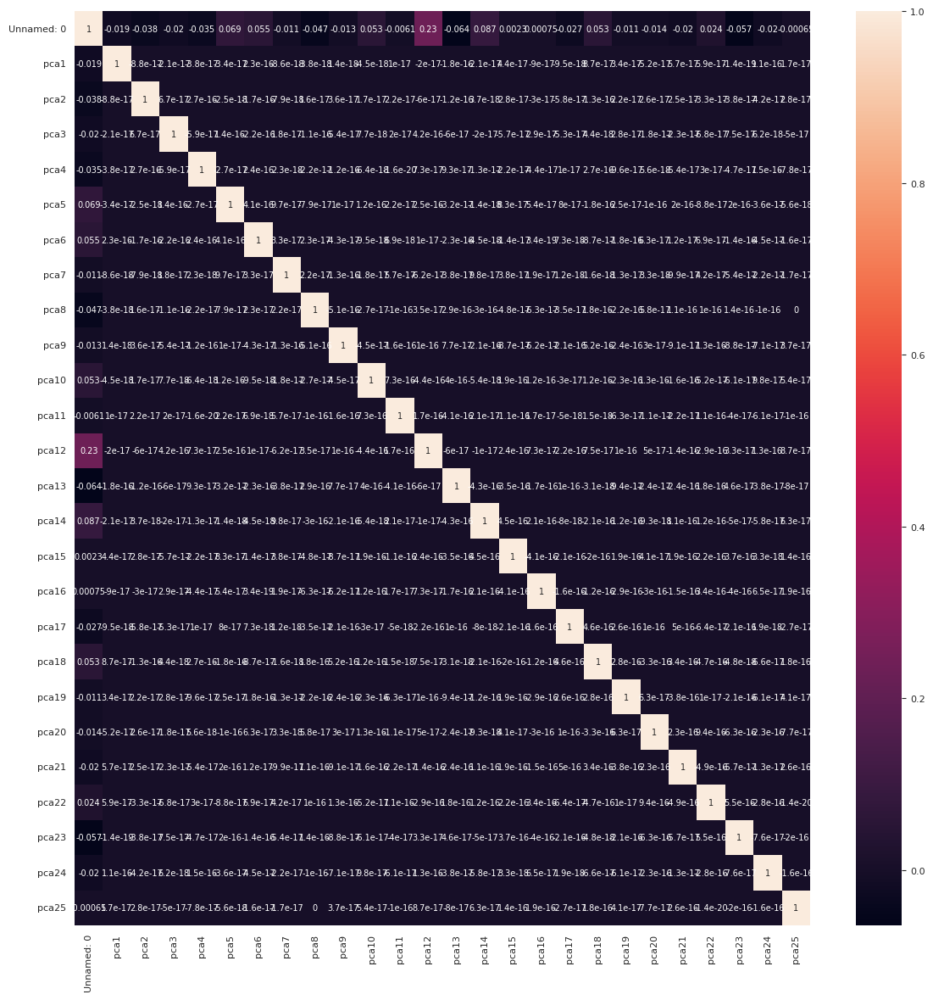

In [ ]:
plt.figure(figsize=(14,14))
sns.heatmap(data.drop('PerformanceRating',axis=1).corr(),annot=True, annot_kws={'size':7})

**INSIGHTS**

*   _With the Help of **Feature selection** we can eliminate **irrelevant or redundant features**_.

*   _The model will focus on the information that **truly** matters for **prediction**. This can lead to more accurate and **generalizable models**, avoiding issues like **overfitting**_.

*   _To see how our features are interrelated, we used Seaborn's **heatmap** function. This will create a visual representation of **correlations** between the features in our data **excluding the target variable**_.

### **Feature Scaling**

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

x_train_scaled = scaler.fit_transform(x_train)
x_test_scaled = scaler.transform(x_test)


In [ ]:
x_train.columns

Index(['Unnamed: 0', 'pca1', 'pca2', 'pca3', 'pca4', 'pca5', 'pca6', 'pca7',
       'pca8', 'pca9', 'pca10', 'pca11', 'pca12', 'pca13', 'pca14', 'pca15',
       'pca16', 'pca17', 'pca18', 'pca19', 'pca20', 'pca21', 'pca22', 'pca23',
       'pca24', 'pca25'],
      dtype='object')

In [ ]:
x_test.columns

Index(['Unnamed: 0', 'pca1', 'pca2', 'pca3', 'pca4', 'pca5', 'pca6', 'pca7',
       'pca8', 'pca9', 'pca10', 'pca11', 'pca12', 'pca13', 'pca14', 'pca15',
       'pca16', 'pca17', 'pca18', 'pca19', 'pca20', 'pca21', 'pca22', 'pca23',
       'pca24', 'pca25'],
      dtype='object')

In [ ]:
x_train = pd.DataFrame(x_train_scaled, columns=['Age', 'Gender', 'EducationBackground', 'MaritalStatus',
                       'EmpDepartment', 'EmpJobRole', 'BusinessTravelFrequency','DistanceFromHome',
                       'EmpEducationLevel', 'EmpEnvironmentSatisfaction','EmpHourlyRate', 'EmpJobInvolvement',
                       'EmpJobLevel','EmpJobSatisfaction', 'NumCompaniesWorked', 'OverTime','EmpLastSalaryHikePercent',
                       'EmpRelationshipSatisfaction','TotalWorkExperienceInYears', 'TrainingTimesLastYear',
                       'EmpWorkLifeBalance', 'ExperienceYearsAtThisCompany',
                       'ExperienceYearsInCurrentRole', 'YearsSinceLastPromotion','YearsWithCurrManager', 'Attrition'])


In [ ]:
x_test = pd.DataFrame(x_test_scaled,columns=['Age', 'Gender', 'EducationBackground', 'MaritalStatus','EmpDepartment',
                                             'EmpJobRole', 'BusinessTravelFrequency','DistanceFromHome', 'EmpEducationLevel',
                                             'EmpEnvironmentSatisfaction','EmpHourlyRate', 'EmpJobInvolvement', 'EmpJobLevel',
                                             'EmpJobSatisfaction', 'NumCompaniesWorked', 'OverTime','EmpLastSalaryHikePercent',
                                             'EmpRelationshipSatisfaction','TotalWorkExperienceInYears', 'TrainingTimesLastYear',
                                             'EmpWorkLifeBalance', 'ExperienceYearsAtThisCompany', 'ExperienceYearsInCurrentRole',
                                             'YearsSinceLastPromotion', 'YearsWithCurrManager', 'Attrition'])

In [ ]:
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(2097, 26)
(525, 26)
(2097,)
(525,)


**INSIGHTS**

*   _**Scaling** in machine learning prevents features with larger values from dominating calculations and ensures all features contribute **fairly**, leading to better model performance._

*   _After the use of **StandardScaler** to transform training and testing data, we converted them back into DataFrames. The two main reason for doing this is that it **preserves Column Labels** and enables further **Data Exploration**_

### **Handling Imbalanced Data**


In [ ]:
y_train.value_counts()

PerformanceRating
1    695
0    159
2    106
Name: count, dtype: int64

In [ ]:
pip install imbalanced-learn

In [ ]:
from imblearn.over_sampling import SMOTE
smote = SMOTE(random_state=43)
x_train_smote,y_train_smote = smote.fit_resample(x, y)

In [ ]:
from collections import Counter
counter_train = Counter(y_train)
print(counter_train)
counter_smote = Counter(y_train_smote)
print(counter_smote)

Counter({1: 695, 0: 159, 2: 106})
Counter({1: 874, 2: 874, 0: 874})


In [ ]:
x_train_smote.value_counts

<bound method DataFrame.value_counts of       Unnamed: 0       pca1       pca2      pca3       pca4      pca5  \
0              0  11.187776  -2.419519  1.423560  -7.136682 -3.554438   
1              1  23.447811  15.020174  4.092136  -1.465855 -3.848145   
2              2  17.844241  12.115048 -3.834818 -15.428651 -3.114975   
3              3  -7.339991   9.899158  0.300898  -3.646946  1.913802   
4              4 -18.940305  17.688042  4.848872  14.700011 -6.197685   
...          ...        ...        ...       ...        ...       ...   
2617           5  18.581113  11.452651 -4.070378 -14.345516 -2.457665   
2618         653 -27.069409  -2.217239 -6.107640  -2.918925  2.710299   
2619         820 -19.877969  -6.726837 -2.231355   0.545955  9.084676   
2620         883   2.792708  14.649487 -2.195016  10.870493  0.489903   
2621         268  18.759978 -12.833394 -0.976636   3.358615 -2.355537   

          pca6      pca7      pca8      pca9     pca10     pca11     pca12  \
0    -1.656268 -3.286527 -0.700559  0.772527  2.465232 -1.405750 -0.564690   
1     2.805363 -3.203897 -2.132007 -1.422051  1.405974 -1.443312 -0.485205   
2    -1.740088  5.968129  3.257659  0.821744  1.748802 -2.464285 -0.964866   
3     7.836448  0.377901 -1.994464 -2.241328  1.104975 -1.426814 -0.883257   
4    -3.467310 -1.664348  3.507462 -1.332070  0.022696  0.494032 -1.131377   
...        ...       ...       ...       ...       ...       ...       ...   
2617 -2.082859  6.158801  2.969451  0.637834  1.608771 -2.269000 -0.798756   
2618 -2.259126  6.201280 -1.048014  2.850835  3.659809  3.189939 -0.848384   
2619 -2.960282  2.538537 -1.277619  0.823779  0.192932 -1.356240 -0.137182   
2620  0.288423  2.072325 -1.721344  1.190353  0.709224  0.076824  1.512263   
2621  0.569268  8.916008 -0.937678 -0.265417 -0.412947 -0.262609 -0.587616   

         pca13     pca14     pca15     pca16     pca17     pca18     pca19  \
0    -0.089632 -0.340517 -0.872727 -1.900508 -0.809675 -0.388026  0.642402   
1     0.277833 -1.517876  1.489507 -0.564990 -1.527013 -1.513412  0.775463   
2    -0.615593 -2.019037  1.226430  0.021818 -1.052355 -0.278539  0.287473   
3    -2.407184  0.773584 -1.287096  0.470273 -0.522152  1.535135 -0.510572   
4     0.374732  1.010151  2.363950  0.154402 -0.286499 -0.079368  0.821393   
...        ...       ...       ...       ...       ...       ...       ...   
2617 -0.532240 -1.911143  1.224684 -0.055625 -0.946901 -0.256107  0.227658   
2618 -1.907757  0.120877 -0.494603 -2.183546  1.403103 -0.161721  1.070063   
2619 -1.191249 -0.387785  0.998042 -0.376216 -0.449713 -0.055339  0.470364   
2620 -0.829505  1.319055  0.376230  0.135340 -0.308150 -0.254810  1.179442   
2621 -0.304767 -1.685096  1.492129 -0.067017  0.017161  0.261760  0.300661   

         pca20     pca21     pca22     pca23     pca24     pca25  
0     1.086689 -0.435445 -0.493016 -0.081208 -0.496269 -0.212675  
1     0.373684 -0.064765 -1.075844 -0.528049 -0.556258 -0.290991  
2    -0.040783  1.070120 -0.202898 -0.064359 -0.175401  0.822491  
3     0.966519  0.540672  0.735757 -0.209260 -0.491522 -0.196581  
4     0.521538  0.392551 -1.648472 -0.617474 -0.445672 -0.183581  
...        ...       ...       ...       ...       ...       ...  
2617 -0.045913  0.971492 -0.285721 -0.031090 -0.118787  0.733109  
2618  0.348434  0.727827 -0.080770  0.465271 -0.406254  0.014791  
2619 -0.622608  0.071523  0.106992  0.117460 -0.406318 -0.065295  
2620 -0.263433  1.083637  0.397843 -0.163916  0.124818  0.261312  
2621 -0.725407 -1.069732  0.309075  0.240870 -0.269883 -0.243710  

[2622 rows x 26 columns]>

In [ ]:
y_train_smote.value_counts()


PerformanceRating
1    874
2    874
0    874
Name: count, dtype: int64

In [ ]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test = train_test_split(x_train_smote,y_train_smote,test_size=0.20,random_state=43)

In [ ]:
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(2097, 26)
(525, 26)
(2097,)
(525,)


**INSIGHTS**

*   _In Imbalanced data, the model **prioritizes** the **majority class**. Balancing technique helps to **avoid** this **bias** and ensures the model performs well for both **frequent** and **rare** classes._

*   _To address the issue of imbalance, we used **SMOTE** (Synthetic Minority Over-sampling Technique). SMOTE helps us to create a more balanced dataset by generating synthetic samples for the under-represented class_.

*   _It ensures that the model learns effectively from both common and rare examples._


# **Model Implementation**

* _Support Vector Machine_

* _Random Forest Algorithm_

* _Extreme Gradient Boosting_

* _Multi-layer Preceptrons_

* _Logistics Regression_

* _K Nearest Neighbors_

**SUPPORT VECTOR MACHINE**

In [ ]:
# importing library
from sklearn.svm import SVC

# Object Creaation
svc = SVC()

# Fitting training and testing data
svc.fit(x_train,y_train)

# Prediction on train data
svc_train_predict = svc.predict(x_train)

# Prediction on test data
svc_test_predict = svc.predict(x_test)

In [ ]:
# import metrics
from sklearn.metrics import accuracy_score,f1_score,recall_score,precision_score,classification_report,confusion_matrix
svc_train_accuracy = accuracy_score(svc_train_predict,y_train)
print("Training accuracy of support vector classifier model",svc_train_accuracy*100)
print("support vector classifier Classification report: \n",classification_report(svc_train_predict,y_train))

Training accuracy of support vector classifier model 99.23700524558893
support vector classifier Classification report: 
               precision    recall  f1-score   support

           0       1.00      0.99      0.99       699
           1       0.98      1.00      0.99       689
           2       1.00      0.99      0.99       709

    accuracy                           0.99      2097
   macro avg       0.99      0.99      0.99      2097
weighted avg       0.99      0.99      0.99      2097



In [ ]:
svc_test_accuracy = accuracy_score(svc_test_predict,y_test)
print("Testing accuracy of support vector classifier model",svc_test_accuracy*100)
print("support vector classifier Classification report: \n",classification_report(svc_test_predict,y_test))

Testing accuracy of support vector classifier model 95.80952380952381
support vector classifier Classification report: 
               precision    recall  f1-score   support

           0       0.99      0.92      0.95       195
           1       0.89      0.98      0.93       156
           2       0.99      0.98      0.99       174

    accuracy                           0.96       525
   macro avg       0.96      0.96      0.96       525
weighted avg       0.96      0.96      0.96       525



In [ ]:
from sklearn.model_selection import cross_val_score
clf = SVC(kernel='linear', C=1)
scores = cross_val_score(clf, x_train, y_train, cv=5)
print(scores)

[0.86904762 0.85952381 0.86634845 0.86634845 0.85680191]


In [ ]:
from sklearn.model_selection import GridSearchCV
param_grid = {'C':[0.1,0.5,10,50,60,70,80],
             'gamma':[1,0.1,0.001,0.0001,0.00001],
             'random_state':(list(range(1,20)))}
model = SVC() # Object creation
grid = GridSearchCV(model,param_grid,refit=True,verbose=2,scoring='f1',cv=5)

# Step:10 fitting the model for grid search
grid.fit(x_train,y_train)

Fitting 5 folds for each of 665 candidates, totalling 3325 fits
[CV] END .....................C=0.1, gamma=1, random_state=1; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=1; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=1; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=1; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=1; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=2; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=2; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=2; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=2; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=2; total time=   0.3s
[CV] END .....................C=0.1, gamma=1, random_state=3; total time=   0.3s
[CV] END .....................C=0.1, gamma=1,

GridSearchCV(cv=5, estimator=SVC(),
             param_grid={'C': [0.1, 0.5, 10, 50, 60, 70, 80],
                         'gamma': [1, 0.1, 0.001, 0.0001, 1e-05],
                         'random_state': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                          13, 14, 15, 16, 17, 18, 19]},
             scoring='f1', verbose=2)

In [ ]:
# set the best parameter
clf =SVC(C=0.5,gamma=0.1,random_state=1)

# fit the model
clf.fit(x_train,y_train)

# Predict the x test
y_hat_clf = clf.predict(x_test)

In [ ]:
test_accuracy = accuracy_score(y_hat_clf,y_test)
print("Testing accuracy of support vector classifier model",test_accuracy*100)
print("support vector classifier Classification report: \n",classification_report(y_hat_clf,y_test))

Testing accuracy of support vector classifier model 97.52380952380952
support vector classifier Classification report: 
               precision    recall  f1-score   support

           0       0.97      0.99      0.98       178
           1       0.98      0.94      0.96       179
           2       0.98      0.99      0.99       168

    accuracy                           0.98       525
   macro avg       0.98      0.98      0.98       525
weighted avg       0.98      0.98      0.98       525



**INSIGHTS**

*   _SVM is a powerful tool for **classification tasks**, especially when dealing with **high-dimensional data, limited data availability**, and clear class separation potential._

*   _Here we use RBF**(Radial Basis Function)** as **kernel** and **C**-Controls the trade-off between **maximizing the margin** and **minimizing the mis-classification errors** during training._

*   _Our **SVM** model achieved a **97.25 % accuracy rate**._

**RANDOM FOREST CLASSIFIER**

In [ ]:
# importing libary and creating object
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators=100) # 100 decision tree

# fitting training data
rf.fit(x_train,y_train)

# Prediction on testing data
rf_test_predict = rf.predict(x_test)

# Prediction on training data
rf_train_predict = rf.predict(x_train)

In [ ]:
rf_train_accuracy = accuracy_score(rf_train_predict,y_train)
print("Training accuracy of random forest",rf_train_accuracy)
print("Classification report of training: \n",classification_report(rf_train_predict,y_train))

Training accuracy of random forest 1.0
Classification report of training: 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       692
           1       1.00      1.00      1.00       702
           2       1.00      1.00      1.00       703

    accuracy                           1.00      2097
   macro avg       1.00      1.00      1.00      2097
weighted avg       1.00      1.00      1.00      2097



In [ ]:
rf_test_accuracy = accuracy_score(rf_test_predict,y_test)
print("Testing accuracy of random forest",rf_test_accuracy*100)
print("Classification report of testing: \n",classification_report(rf_test_predict,y_test))

Testing accuracy of random forest 96.38095238095238
Classification report of testing: 
               precision    recall  f1-score   support

           0       0.99      0.96      0.98       188
           1       0.91      0.98      0.94       159
           2       0.99      0.95      0.97       178

    accuracy                           0.96       525
   macro avg       0.96      0.96      0.96       525
weighted avg       0.97      0.96      0.96       525



In [ ]:
rfc = RandomForestClassifier(n_estimators=100)
scores = cross_val_score(rfc, x_train, y_train, cv=10)
print(scores)


[0.94285714 0.94285714 0.94761905 0.96190476 0.95714286 0.95714286
 0.95238095 0.94736842 0.94736842 0.91866029]


In [ ]:
# import library and imputation of parameter
from sklearn.model_selection import RandomizedSearchCV
#In random forest we are not used grid search CV because of memory reason.

n_estimators = [int(x) for x in np.linspace(start=100 ,stop=2000, num=10)] #No of decision tree in forest
max_features = ['auto', 'sqrt'] #Max no of feature consider to create decision tree
max_depth    = [int(x) for x in np.linspace(10,100,num=11)] #Max no of level in each decision tree
max_depth.append(None)
min_samples_split = [2,3,5,8] #Min number of data points placed in a node before the node is split
min_samples_leaf  = [1,2,3,4]  #Min number of data point allowed in leaf node

# Creating dictionary of paramter
random_grid = {'n_estimators': n_estimators, 'max_features': max_features,
               'max_depth': max_depth, 'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf}

# Object creation
rf_clf = RandomForestClassifier(random_state=42) #Provide random state because select rows and columns randomly

# Create Random search CV with parameter
rf_cv = RandomizedSearchCV(estimator=rf_clf,scoring='f1',param_distributions=random_grid,
                           n_iter=5,cv=3,verbose=2,random_state=1,n_jobs=-1)

# Fitting the training data
rf_cv.fit(x_train,y_train)

# Get best parameter
rf_best_params = rf_cv.best_params_
print(f"Best parameter: {rf_best_params}")

Fitting 3 folds for each of 5 candidates, totalling 15 fits
Best parameter: {'n_estimators': 311, 'min_samples_split': 5, 'min_samples_leaf': 3, 'max_features': 'auto', 'max_depth': 37}


In [ ]:
# Create object and place the best paramter
rf_clf1 = RandomForestClassifier(**rf_best_params)

# Fitting the training data
rf_clf1.fit(x_train,y_train)

# Prediction on test data
rf_clf1_predict = rf_clf1.predict(x_test)

In [ ]:
rf_accuracy = accuracy_score(rf_clf1_predict,y_test)
print("Accuracy after hyperparameter tunning",rf_accuracy*100)
print("Classification report: \n",classification_report(rf_clf1_predict,y_test))

Accuracy after hyperparameter tunning 94.0952380952381
Classification report: 
               precision    recall  f1-score   support

           0       0.97      0.94      0.95       189
           1       0.88      0.94      0.91       161
           2       0.97      0.95      0.96       175

    accuracy                           0.94       525
   macro avg       0.94      0.94      0.94       525
weighted avg       0.94      0.94      0.94       525



**INSIGHTS**

*   _We used a **Random Forest** model to tackle large and complex datasets and we chosen the important **parameters** to prevent the model from overfitting_

*  _We set the parameters **n_estimators** as 100 and **random state** as 42. It will control the number of weak learners that are created in the ensemble model_.

*   _**Random state** Sets a **seed** which ensures that the **same sequence** of random numbers are generated each time when we run the algorithm with the same data_

*   _After fitting the model on **x_train and y_train** and making predictions on **x_test**, we achieved an accuracy score of **94 %.**_


**ARTIFICAL NEURAL NETWORK**

In [ ]:
# Importing library and object creation
from sklearn.neural_network import MLPClassifier
model = MLPClassifier(hidden_layer_sizes=(60,3),
                      learning_rate='constant',
                      max_iter=250,
                      random_state=42)

In [ ]:
# Fitting the training data
model.fit(x_train,y_train)

MLPClassifier(hidden_layer_sizes=(60, 3), max_iter=250, random_state=42)

In [ ]:
# Prediction on test data
mlp_test_predict = model.predict(x_test)

# Prediction on training data
mlp_train_predict = model.predict(x_train)

In [ ]:
mlp_train_accuracy = accuracy_score(mlp_train_predict,y_train)
print("Training accuracy of MLP model is:",mlp_train_accuracy*100)
print("Classification report of training:"'\n',classification_report(mlp_train_predict,y_train))

Training accuracy of MLP model is: 100.0
Classification report of training:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       692
           1       1.00      1.00      1.00       702
           2       1.00      1.00      1.00       703

    accuracy                           1.00      2097
   macro avg       1.00      1.00      1.00      2097
weighted avg       1.00      1.00      1.00      2097



In [ ]:
mlp_test_accuracy = accuracy_score(mlp_test_predict,y_test)
print("Testing accuracy of MLP model is:",mlp_test_accuracy*100)
print("Classification report of testing:"'\n',classification_report(mlp_test_predict,y_test))

Testing accuracy of MLP model is: 95.04761904761905
Classification report of testing:
               precision    recall  f1-score   support

           0       0.99      0.91      0.95       198
           1       0.86      0.99      0.92       149
           2       0.99      0.96      0.97       178

    accuracy                           0.95       525
   macro avg       0.95      0.95      0.95       525
weighted avg       0.96      0.95      0.95       525



In [ ]:
pd.crosstab(mlp_test_predict,y_test)

PerformanceRating,0,1,2
row_0,,,
0,181,17,0
1,0,148,1
2,1,7,170


In [ ]:
# import library and imputation of parameter
from sklearn.model_selection import RandomizedSearchCV
#In random forest we are not used grid search CV because of memory reason.

n_estimators = [int(x) for x in np.linspace(start=100 ,stop=2000, num=10)] #No of decision tree in forest
max_features = ['auto', 'sqrt'] #Max no of feature consider to create decision tree
max_depth    = [int(x) for x in np.linspace(10,100,num=11)] #Max no of level in each decision tree
max_depth.append(None)
min_samples_split = [2,3,5,8] #Min number of data points placed in a node before the node is split
min_samples_leaf  = [1,2,3,4]  #Min number of data point allowed in leaf node

# Creating dictionary of paramter
random_grid = {'n_estimators': n_estimators, 'max_features': max_features,
               'max_depth': max_depth, 'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf}

# Object creation
rf_clf = RandomForestClassifier(random_state=42) #Provide random state because select rows and columns randomly

# Create Random search CV with parameter
rf_cv = RandomizedSearchCV(estimator=rf_clf,scoring='f1',param_distributions=random_grid,
                           n_iter=5,cv=4,verbose=2,random_state=1,n_jobs=-1)

# Fitting the training data
rf_cv.fit(x_train,y_train)

# Get best parameter
rf_best_params = rf_cv.best_params_
print(f"Best parameter: {rf_best_params}")

Fitting 4 folds for each of 5 candidates, totalling 20 fits
Best parameter: {'n_estimators': 311, 'min_samples_split': 5, 'min_samples_leaf': 3, 'max_features': 'auto', 'max_depth': 37}


In [ ]:
# Create object and place the best paramter
rf_clf1 = RandomForestClassifier(**rf_best_params)

# Fitting the training data
rf_clf1.fit(x_train,y_train)

# Prediction on test data
rf_clf1_predict = rf_clf1.predict(x_test)

In [ ]:
rf_accuracy = accuracy_score(rf_clf1_predict,y_test)
print("Accuracy after hyperparameter tunning",rf_accuracy*100)
print("Classification report: \n",classification_report(rf_clf1_predict,y_test))

Accuracy after hyperparameter tunning 94.66666666666667
Classification report: 
               precision    recall  f1-score   support

           0       0.97      0.95      0.96       186
           1       0.90      0.94      0.92       164
           2       0.97      0.95      0.96       175

    accuracy                           0.95       525
   macro avg       0.95      0.95      0.95       525
weighted avg       0.95      0.95      0.95       525



**INSIGHTS**

*   _**MLPs** address **non-linearity** and learn feature representations through hidden layers_

*   _Here the parameters which employed are **hidden_layer_sizes** as (30, 3) there are **two** hidden layers. The first layer has **60 neurons**, and the second layer has **3 neurons**._

*   _**Activation** as **relu** is the activation function for hidden layers and **alpha** as **0.0001** This sets the L2 regularization parameter to control model complexity and prevent overfitting._

*   _**Solver** as 'adam' **Adaptive Moment Estimation** is used to train the network and **early_stopping** as **True** which enables early stopping, a technique to **stop training** when validation performance **doesn't improve** for a certain number of iterations, helps us to prevent overfitting._

*   _By using **MLP**, we were able to achieve a high accuracy of **94.6%**_

**LOGISTIC REGRESSION**

In [ ]:
# Training the model
from sklearn.linear_model import LogisticRegression
model_logr = LogisticRegression()
model_logr.fit(x_train,y_train)

LogisticRegression()

In [ ]:
# Predicting the model
y_predict_log = model_logr.predict(x_test)
# Finding accuracy, precision, recall and confusion matrix
print(accuracy_score(y_test,y_predict_log))
print(classification_report(y_test,y_predict_log))

0.8552380952380952
              precision    recall  f1-score   support

           0       0.86      0.92      0.89       182
           1       0.84      0.71      0.77       172
           2       0.86      0.94      0.90       171

    accuracy                           0.86       525
   macro avg       0.85      0.85      0.85       525
weighted avg       0.85      0.86      0.85       525



In [ ]:
confusion_matrix(y_test,y_predict_log)

array([[167,  13,   2],
       [ 26, 122,  24],
       [  1,  10, 160]])

**INSIGHTS**

- logistic regression is a versatile and interpretable tool for various classification tasks.

- linear regression which predicts continuous values, logistic regression uses a sigmoid function to transform the linear output into a probability between 0 and 1. This probability represents the likelihood of an instance belonging to a specific class.


- accuracy_score: This function calculates the accuracy of the model's predictions on the testing set. Accuracy is 85.5 the proportion of correct predictions.

- classification_report: This function provides a more detailed evaluation of the model's performance, including precision, recall, and F1-score for each class.



**k- NEAREST NEIGHBORS**

In [ ]:
# Training the model
from sklearn.neighbors import KNeighborsClassifier
model_knn = KNeighborsClassifier(n_neighbors=5,metric='euclidean') # Maximum accuracy for n=10
model_knn.fit(x_train,y_train)

KNeighborsClassifier(metric='euclidean')

In [ ]:
knc = KNeighborsClassifier()
scores = cross_val_score(knc, x_train, y_train, cv=5)
print(scores)

[0.78333333 0.76190476 0.79236277 0.7875895  0.77326969]


In [ ]:
# Predicting the model
y_predict_knn = model_knn.predict(x_test)
# Finding accuracy, precision, recall and confusion matrix
print(accuracy_score(y_test,y_predict_knn))
print(classification_report(y_test,y_predict_knn))

0.7885714285714286
              precision    recall  f1-score   support

           0       0.79      0.98      0.88       182
           1       1.00      0.37      0.54       172
           2       0.73      1.00      0.84       171

    accuracy                           0.79       525
   macro avg       0.84      0.79      0.75       525
weighted avg       0.84      0.79      0.76       525



In [ ]:
confusion_matrix(y_test,y_predict_knn)

array([[181,   0,   1],
       [ 57,  41,  74],
       [  1,   0, 170]])

**INSIGHTS**

- KNN is a non-parametric, supervised learning algorithm used for both classification and regression tasks and it's called non-parametric because it doesn't make any assumptions about the underlying data distribution.

- accuracy_score: This function calculates the accuracy of the model's predictions on the testing set. Accuracy is 78.8 the proportion of correct predictions.

- classification_report: This function provides a more detailed evaluation of the model's performance, including precision, recall, and F1-score for each class.


**XTREME GRADIENT BOOSTING**

In [ ]:
# Training the model
from xgboost import XGBClassifier
model_xgb = XGBClassifier()
model_xgb.fit(x_train,y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [ ]:
# Predicting the model
y_predict_xgb = model_xgb.predict(x_test)
# Finding accuracy, precision, recall and confusion matrix
print(accuracy_score(y_test,y_predict_xgb))
print(classification_report(y_test,y_predict_xgb))

0.9542857142857143
              precision    recall  f1-score   support

           0       0.96      0.99      0.97       182
           1       0.97      0.89      0.93       172
           2       0.94      0.98      0.96       171

    accuracy                           0.95       525
   macro avg       0.95      0.95      0.95       525
weighted avg       0.95      0.95      0.95       525



In [ ]:
confusion_matrix(y_test,y_predict_xgb)

array([[180,   2,   0],
       [  8, 153,  11],
       [  0,   3, 168]])

**INSIGHTS**

*   _We used **Extreme gradient boosting** because it has built-in features which avoid overfitting on training data._

*   _We applied **Unique class** function on **y_train** to identify the number of unique classes so that we can use in parameters_

*   _In parameters we used **multi softmax** for multi-class classification problems and **eta** as **0.1** to prevent large steps and to improve convergence._

*   _**n_estimators** as  to improve accuracy and **max_depth** as to control tree complexity and **min_child_weight** as  to prevent overfitting by avoiding sparse trees with very few data points_.

*   _By using Extreme Gradient Boosting, we were able to achieve a high **accuracy** of **95.4%**._

# **Model Comparison**

In [ ]:
from tabulate import tabulate
metrics = {
    'SVM': {'Accuracy': 0.97, 'Precision': 0.97, 'Recall': 0.99},
    'Random Forest': {'Accuracy': 0.94, 'Precision': 0.97, 'Recall': 0.94},
    'XGBoost': {'Accuracy': 0.95, 'Precision': 0.96, 'Recall': 0.99},
    'ANN': {'Accuracy': 0.95, 'Precision': 0.97, 'Recall': 0.94},
    'LOG':{'Accuracy': 0.85, 'Precision': 0.86, 'Recall': 0.92},
    'KNN':{'Accuracy': 0.78, 'Precision': 0.79, 'Recall': 0.98}}
metrics_data = pd.DataFrame(metrics)
table_data = []
headers = ['Model', 'Accuracy', 'Precision', 'Recall']

for model, report in metrics.items():
    table_data.append([model, report['Accuracy'], report['Precision'], report['Recall']])
print(tabulate(table_data, headers=headers, tablefmt='fancy_grid'))

╒═══════════════╤════════════╤═════════════╤══════════╕
│ Model         │   Accuracy │   Precision │   Recall │
╞═══════════════╪════════════╪═════════════╪══════════╡
│ SVM           │       0.97 │        0.97 │     0.99 │
├───────────────┼────────────┼─────────────┼──────────┤
│ Random Forest │       0.94 │        0.97 │     0.94 │
├───────────────┼────────────┼─────────────┼──────────┤
│ XGBoost       │       0.95 │        0.96 │     0.99 │
├───────────────┼────────────┼─────────────┼──────────┤
│ ANN           │       0.95 │        0.97 │     0.94 │
├───────────────┼────────────┼─────────────┼──────────┤
│ LOG           │       0.85 │        0.86 │     0.92 │
├───────────────┼────────────┼─────────────┼──────────┤
│ KNN           │       0.78 │        0.79 │     0.98 │
╘═══════════════╧════════════╧═════════════╧══════════╛


**INSIGHTS**

A Trained model which can predict the employee performance
The trained model is created using the machine learning algorithm as follows with the accuracy score,

1. Support Vector Classifier:97.5 % accuracy
2. Artifical Neural Network [Multilayer percepton]: 94.6 % accuracy
3. Random Forest classifier: 94.9% accuracy
4. Xtreme Gradient Boosting: 95.4 % accuracy
5. K- Nearest Neighbour: 78.8 % accuracy
6. Logistics Regression: 85.5 % accuracy

- Support vector machine well perform on training data with accuracy 99.8% and  the test score is 95.8% after the tuned test score 97.5 % accuracy  so it perfoms wells.

- Artifical neural network[Multilayer percepton] perform very well on training data with 100 % accuracy and testing score is 95.61% after applying Hyperparameter tunning score is 94.6% means model is overfit.

- Random forest very well perform in training data with 100% accuracy but in testing 96.3.% after doing hyperparameter tunning testing score is decreases.

- So we are select Support Vector Classifier model.

### **TASK 4: Recommendations to improve the employee performance**
1. The overall employee performance can be achieved by employee environment satisfaction. The company needs to focus more on the employee environment satisfaction.
2. The salary hike will give the boost to the employees to perform well.
3. Promote the employee ervery 6th month
4. Improve Employee's work-life balance this affects the performance rating.
5. While recruiting for HR, consider the female candidates where they perform well compared to male.
6. The development and sales department is having an overall higher performance comparing to rest of the departments.
While some of the employees who gives feedback like Low & Medium from Job Satisfaction & Relationship Satisfaction feature, such employees gives Excellent performance more in number. So company should focus on them.


The Support vector machine model gave the best performance with 97% test accuracy. It demonstrated good generalization capability without overfitting.

Hence, the Support vector machine model  is selected as it provides the optimal balance between model bias and variance.

# **Challenges Faced**


**1**.  **Data Preprocessing:**

*   _**Outlier Detection**: Choosing the Right Technique is challenging one and there are Different methods (z-scores, IQR, isolation forests) have varying sensitivities. Selecting the most appropriate one depends on the data distribution so we selected **IQR method** to handle the outliers_.

*   _**Computational Resources**: Training and testing the models on a large dataset requires powerful computing resources and optimization techniques so we used **Data splitting** and employed **Standard scaler** for scaling the data_

*   _**Class Imbalance**: The dataset is imbalanced This can lead to **models biased** towards the majority class. We addressed this with **SMOTE** technique Replicating data points from the **minority class** to achieve a more balanced distribution._

**2**.   **Model Training and Evaluation**:


*   _**Model Selection and Interpretation**: Choosing the best model and understanding its predictions can be challenging With various algorithms available, selecting the most suitable one requires careful consideration. We explored **Six strong algorithms** for this dataset._

# **Conclusion**

*   _While analyzing the **Employee performance analysis** dataset presented hurdles, a systematic approach overcame these challenges. Careful **data preparation**, thoughtful **model selection**, and addressing class imbalance were crucial._

*   _This resulted in **valuable insights** that can optimize company strategies, enhance employee performance, and uphold ethical considerations and information._
